# Online News Popularity Prediction

Mashable Inc., founded in 2005, is a digital media site known as a go-to hub for social media content. As of November 2015, Mashable boasts over 6,000,000 Twitter followers and more than 3,200,000 Facebook fans.

This dataset gathers articles published by Mashable over a two-year period, covering 59 numerical attributes that detail different aspects of each article. It includes data from 39,644 articles available from the Mashable website and can be accessed publicly via the University of California Irvine Machine Learning Repository.

The main goal is to predict how popular articles are by anticipating the number of shares on social networks. 

data source: https://archive.ics.uci.edu/dataset/332/online+news+popularity

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
import seaborn as sns

# EDA

### Ideas for Exploring the Dataset:
Media Effect:
* Examine the impact of the number of images and videos on article popularity.
* Investigate the relationship between the number of links to other Mashable articles and the popularity of the main article.
* Explore if the number of shares in referenced articles influences the shares in the main article (features: self_reference_min_shares, self_reference_max_shares, self_reference_avg_sharess).

Channel and Day:
* Identify the most popular type of channel and analyze contributing features for its popularity.
* Investigate whether the day of publication (weekday vs. weekend) influences popularity.

Words and Length Effect:
* Analyze the impact of the number of words in the content and title on article popularity.
* Investigate whether the length of tokens in content affects article popularity.
* Explore the effects of features such as n_unique_tokens, n_non_stop_words, n_non_stop_unique_tokens, and assess if they can be removed.
* Explore the effects of the worst, best, and average keywords.

Sentiment Effect:
* Investigate if articles with more positive/negative sentiment influence popularity.
* Analyze whether sentiment polarity influences article popularity.

Subjectivity Effect:
* Analyze the effect of subjectivity on both the title and content in relation to popularity.

LDA Effect:
* Investigate the impact of LDA analysis on article popularity.

Interaction between Features:
* Analyze how the distribution of article types varies across different days of the week and channels. (Channel and Day)
* What the subjectivity and sentiment in different channels and publication days? (Sentimentand and Subjectivity vs. Channel and Day)

### Read Data

In [118]:
df = pd.read_csv('OnlineNewsPopularity.csv')
print(df.shape)
print(df.columns)
df_original = df.copy()
df.head()

(39644, 61)
Index(['url', ' timedelta', ' n_tokens_title', ' n_tokens_content',
       ' n_unique_tokens', ' n_non_stop_words', ' n_non_stop_unique_tokens',
       ' num_hrefs', ' num_self_hrefs', ' num_imgs', ' num_videos',
       ' average_token_length', ' num_keywords', ' data_channel_is_lifestyle',
       ' data_channel_is_entertainment', ' data_channel_is_bus',
       ' data_channel_is_socmed', ' data_channel_is_tech',
       ' data_channel_is_world', ' kw_min_min', ' kw_max_min', ' kw_avg_min',
       ' kw_min_max', ' kw_max_max', ' kw_avg_max', ' kw_min_avg',
       ' kw_max_avg', ' kw_avg_avg', ' self_reference_min_shares',
       ' self_reference_max_shares', ' self_reference_avg_sharess',
       ' weekday_is_monday', ' weekday_is_tuesday', ' weekday_is_wednesday',
       ' weekday_is_thursday', ' weekday_is_friday', ' weekday_is_saturday',
       ' weekday_is_sunday', ' is_weekend', ' LDA_00', ' LDA_01', ' LDA_02',
       ' LDA_03', ' LDA_04', ' global_subjectivity',
       '

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [119]:
# Remove leading spaces from column names
df.columns = df.columns.str.strip()
df.columns

Index(['url', 'timedelta', 'n_tokens_title', 'n_tokens_content',
       'n_unique_tokens', 'n_non_stop_words', 'n_non_stop_unique_tokens',
       'num_hrefs', 'num_self_hrefs', 'num_imgs', 'num_videos',
       'average_token_length', 'num_keywords', 'data_channel_is_lifestyle',
       'data_channel_is_entertainment', 'data_channel_is_bus',
       'data_channel_is_socmed', 'data_channel_is_tech',
       'data_channel_is_world', 'kw_min_min', 'kw_max_min', 'kw_avg_min',
       'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg',
       'kw_avg_avg', 'self_reference_min_shares', 'self_reference_max_shares',
       'self_reference_avg_sharess', 'weekday_is_monday', 'weekday_is_tuesday',
       'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday',
       'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
     

### Preprocessing

In [120]:
# drop meta data which will not contribute to model prediction
df.drop(labels=['url', 'timedelta'], axis=1, inplace=True)
df.head()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [121]:
df.describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,...,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,10.398749,546.514731,0.548216,0.996469,0.689175,10.883690,3.293638,4.544143,1.249874,4.548239,...,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,2.114037,471.107508,3.520708,5.231231,3.264816,11.332017,3.855141,8.309434,4.107855,0.844406,...,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,9.000000,246.000000,0.470870,1.000000,0.625739,4.000000,1.000000,1.000000,0.000000,4.478404,...,0.050000,0.600000,-0.328383,-0.700000,-0.125000,0.000000,0.000000,0.166667,0.000000,946.000000
50%,10.000000,409.000000,0.539226,1.000000,0.690476,8.000000,3.000000,1.000000,0.000000,4.664082,...,0.100000,0.800000,-0.253333,-0.500000,-0.100000,0.150000,0.000000,0.500000,0.000000,1400.000000
75%,12.000000,716.000000,0.608696,1.000000,0.754630,14.000000,4.000000,4.000000,1.000000,4.854839,...,0.100000,1.000000,-0.186905,-0.300000,-0.050000,0.500000,0.150000,0.500000,0.250000,2800.000000
max,23.000000,8474.000000,701.000000,1042.000000,650.000000,304.000000,116.000000,128.000000,91.000000,8.041534,...,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.500000,1.000000,843300.000000


Merging the weekdays and channels columns as one single column

Days

In [122]:
day_cols = df[['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday']]
day_arr = []
for r in range(day_cols.shape[0]):
       for c in range(day_cols.shape[1]):
              if c == 0 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Monday')
              elif c == 1 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Tuesday')
              elif c == 2 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Wednesday')
              elif c == 3 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Thursday')
              elif c == 4 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Friday')
              elif c == 5 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Saturday')
              elif c == 6 and day_cols.iloc[r,c] == 1:
                     day_arr.append('Sunday')
print(np.unique(set(day_arr)))

[{'Tuesday', 'Saturday', 'Monday', 'Friday', 'Sunday', 'Thursday', 'Wednesday'}]


Channels

In [123]:
# There is "Others" situation in channel variable, that is, if the data show zero in every categories, it should be assigned "Others"
channel_cols = df[['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world']]
channel_arr = []
for r in range(channel_cols.shape[0]):
    if channel_cols.iloc[r,0] == 0 and channel_cols.iloc[r,1] == 0 and channel_cols.iloc[r,2] == 0 and channel_cols.iloc[r,3] == 0 and channel_cols.iloc[r,4] == 0 and channel_cols.iloc[r,5] == 0:
        channel_arr.append('others')
    for c in range(channel_cols.shape[1]):
            if c == 0 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('lifestyle')
            elif c == 1 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('entertainment')
            elif c == 2 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('business')
            elif c == 3 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('socmed')
            elif c == 4 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('tech')
            elif c == 5 and channel_cols.iloc[r,c] == 1:
                    channel_arr.append('world')
print(np.unique(set(channel_arr)))

[{'socmed', 'lifestyle', 'tech', 'world', 'entertainment', 'business', 'others'}]


In [124]:
# merge the the new data into the dataframe
df.insert(loc = 11, column = 'weekdays', value = day_arr)
df.insert(loc = 12, column = 'channels', value = channel_arr)
df.columns

Index(['n_tokens_title', 'n_tokens_content', 'n_unique_tokens',
       'n_non_stop_words', 'n_non_stop_unique_tokens', 'num_hrefs',
       'num_self_hrefs', 'num_imgs', 'num_videos', 'average_token_length',
       'num_keywords', 'weekdays', 'channels', 'data_channel_is_lifestyle',
       'data_channel_is_entertainment', 'data_channel_is_bus',
       'data_channel_is_socmed', 'data_channel_is_tech',
       'data_channel_is_world', 'kw_min_min', 'kw_max_min', 'kw_avg_min',
       'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg',
       'kw_avg_avg', 'self_reference_min_shares', 'self_reference_max_shares',
       'self_reference_avg_sharess', 'weekday_is_monday', 'weekday_is_tuesday',
       'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday',
       'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
 

In [125]:
# drop the old columns
df.drop(labels=['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday',
                'data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world'], 
                axis = 1, inplace = True)
print(df.shape)
df.columns

(39644, 48)


Index(['n_tokens_title', 'n_tokens_content', 'n_unique_tokens',
       'n_non_stop_words', 'n_non_stop_unique_tokens', 'num_hrefs',
       'num_self_hrefs', 'num_imgs', 'num_videos', 'average_token_length',
       'num_keywords', 'weekdays', 'channels', 'kw_min_min', 'kw_max_min',
       'kw_avg_min', 'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg',
       'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares',
       'self_reference_max_shares', 'self_reference_avg_sharess', 'is_weekend',
       'LDA_00', 'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
       'global_rate_negative_words', 'rate_positive_words',
       'rate_negative_words', 'avg_positive_polarity', 'min_positive_polarity',
       'max_positive_polarity', 'avg_negative_polarity',
       'min_negative_polarity', 'max_negative_polarity', 'title_subjectivity',
       'title_sentiment_polarity', 'abs_title_subjectivity',
       'abs_ti

It's beneficial to classify the shares into 4 categories for a better visualization effect: Popular, Average, Limited, and Negligible.

In [126]:
df['shares'].describe()

count     39644.000000
mean       3395.380184
std       11626.950749
min           1.000000
25%         946.000000
50%        1400.000000
75%        2800.000000
max      843300.000000
Name: shares, dtype: float64

In [127]:
def quartile_popularity(value):
    if value < df['shares'].quantile(0.25):
        return 'Negligible'
    elif value < df['shares'].quantile(0.5):
        return 'Limited'
    elif value < df['shares'].quantile(0.75):
        return 'Average'
    else:
        return 'Popular'

df['vis_pop'] = df['shares'].apply(quartile_popularity)
df.head()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,...,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares,vis_pop
0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,...,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593,Negligible
1,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,...,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711,Negligible
2,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,...,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500,Average
3,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,...,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200,Limited
4,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,...,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505,Negligible


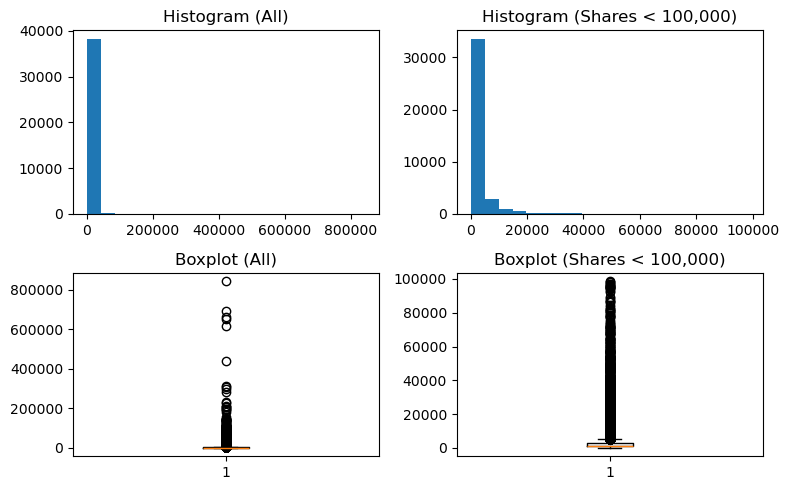

In [285]:
# plt.figure(figsize=(3,3))
# plt.hist(df['shares'][df['shares'] < 20000])
# plt.show()

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 5))

# histograms
axes[0, 0].hist(df['shares'], bins=20)
axes[0, 0].set_title('Histogram (All)')

axes[0, 1].hist(df['shares'][df['shares'] < 100000], bins=20)
axes[0, 1].set_title('Histogram (Shares < 100,000)')

# boxplots
axes[1, 0].boxplot(df['shares'])
axes[1, 0].set_title('Boxplot (All)')

axes[1, 1].boxplot(df['shares'][df['shares'] < 100000])
axes[1, 1].set_title('Boxplot (Shares < 100,000)')

plt.tight_layout()
plt.show()

To enhance pattern observation, the visualizations presented below focus on the subset of data where 'shares' is less than 100,000.

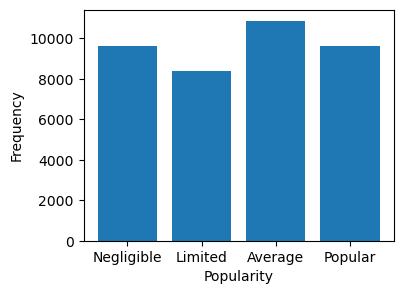

In [185]:
popularity_order = ['Negligible', 'Limited', 'Average', 'Popular']
popularity_counts = df['vis_pop'].value_counts().loc[popularity_order]

plt.figure(figsize = (4,3))
plt.bar(popularity_counts.index, popularity_counts)
plt.ylabel('Frequency')
plt.xlabel('Popularity')
plt.show()

In [219]:
# vis_pop

df['vis_pop'].value_counts()

Average       10867
Negligible     9634
Popular        9596
Limited        8365
Name: vis_pop, dtype: int64

In [224]:
df['shares'].describe()

count     38462.000000
mean       3355.294238
std       11586.112129
min           1.000000
25%         945.000000
50%        1400.000000
75%        2700.000000
max      843300.000000
Name: shares, dtype: float64

### Data Cleaning: Noise detection and removal
Variable categories:
1. Words
    - number of words of the title/content
    - average word length
    - rate of unique/non-stop words of contents
2. Links
    - number of links
    - number of links to other articles in Mashable
3. Referenced Articles 
    - min/max/avg shares
4. Digital Media
    - number of images/videos
5. Publication Time
    - day of the week/weekend
6. Keywords
    - number of keywords
    - worst/best/average keywords (#shares)
    - article category
7. NLP
    - closeness to 5 LDA topics
    - title/text polarity/subjectivity
    - rate and polarity of positive/negative words
    - absolute subjectivity/polarity level
8. Target
    - number of shares

In [128]:
# check NA
df.columns[df.isnull().any()]

Index([], dtype='object')

#### Words
variable names: n_tokens_title, n_tokens_content, average_token_length, n_unique_tokens,  n_non_stop_words, n_non_stop_unique_tokens

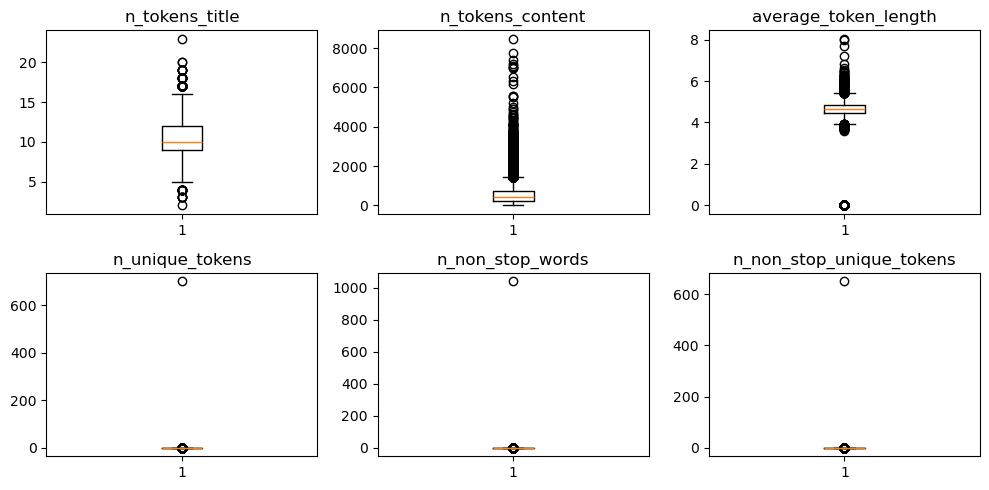

In [129]:
variables = ['n_tokens_title', 'n_tokens_content','average_token_length', 'n_unique_tokens',  'n_non_stop_words', 'n_non_stop_unique_tokens']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10, 5))
for i, var in enumerate(variables):
    row = i // 3
    col = i % 3
    axes[row, col].boxplot(df[var])
    axes[row, col].set_title(var)
plt.tight_layout()
plt.show()

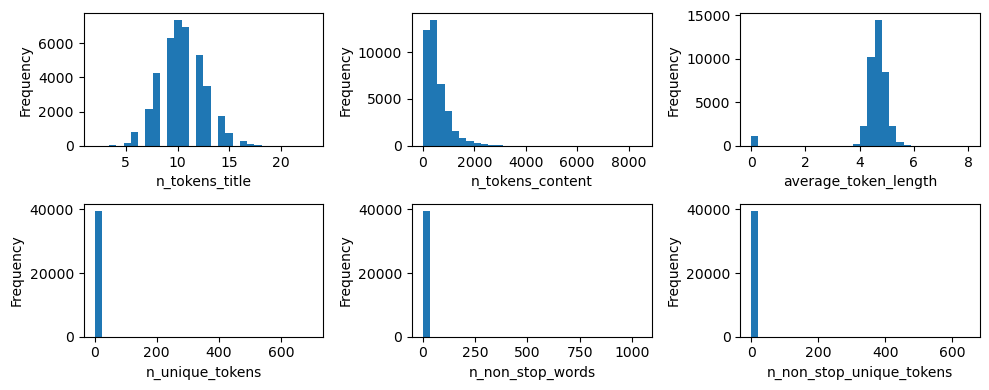

In [131]:
variables = ['n_tokens_title', 'n_tokens_content', 'average_token_length', 'n_unique_tokens', 'n_non_stop_words', 'n_non_stop_unique_tokens']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10, 4))
for i, var in enumerate(variables):
    axes[i // 3, i % 3].hist(df[var], bins=30, label=f'{var}')
    axes[i // 3, i % 3].set_xlabel(var)
    axes[i // 3, i % 3].set_ylabel('Frequency')
plt.tight_layout()
plt.show()

* n_token_title: The distribution seems pretty normal.
* n_tokens_content: Zero tokens are unreasonable.
* average_token_length: Close to zero average tokens are unreasonable.
* n_unique_tokens: It shows the presence of an outlier.
* n_non_stop_words: It shows the presence of an outlier.
* n_non_stop_unique_tokens: It shows the presence of an outlier.

Let's address all the issues.

In [132]:
# n_tokens_content

df['n_tokens_content'].describe()

count    39644.000000
mean       546.514731
std        471.107508
min          0.000000
25%        246.000000
50%        409.000000
75%        716.000000
max       8474.000000
Name: n_tokens_content, dtype: float64

It is unreasonable number of words in the content equal to 0. The noise should be remove.

In [133]:
df = df[df['n_tokens_content'] != 0]
df.shape

(38463, 49)

In [141]:
# average_token_length

df['average_token_length'].describe()

count    38462.000000
mean         4.687892
std          0.283234
min          3.600000
25%          4.496245
50%          4.674120
75%          4.861903
max          8.041534
Name: average_token_length, dtype: float64

In [139]:
# n_unique_tokens

df['n_unique_tokens'].describe()

count    38462.000000
mean         0.546837
std          0.102314
min          0.114964
25%          0.477419
50%          0.542982
75%          0.611111
max          1.000000
Name: n_unique_tokens, dtype: float64

In [142]:
# n_non_stop_words

df['n_non_stop_words'].describe()

count    3.846200e+04
mean     1.000000e+00
std      4.022927e-09
min      9.999999e-01
25%      1.000000e+00
50%      1.000000e+00
75%      1.000000e+00
max      1.000000e+00
Name: n_non_stop_words, dtype: float64

In [287]:
len(df[df['n_non_stop_words'] >= df['n_non_stop_words'].quantile(0.25)])

28894

There are a lot of identical values in this feature, which indicates that the feature provides little information for analysis. It should be dropped.

In [288]:
df.drop(labels=['n_non_stop_words'], axis = 1, inplace=True)

In [143]:
# n_non_stop_unique_tokens

df['n_non_stop_unique_tokens'].describe()

count    38462.000000
mean         0.693455
std          0.100644
min          0.119134
25%          0.632588
50%          0.693727
75%          0.756944
max          1.000000
Name: n_non_stop_unique_tokens, dtype: float64

The outlier has been removed for these three. Plot again to heck their dictribution.

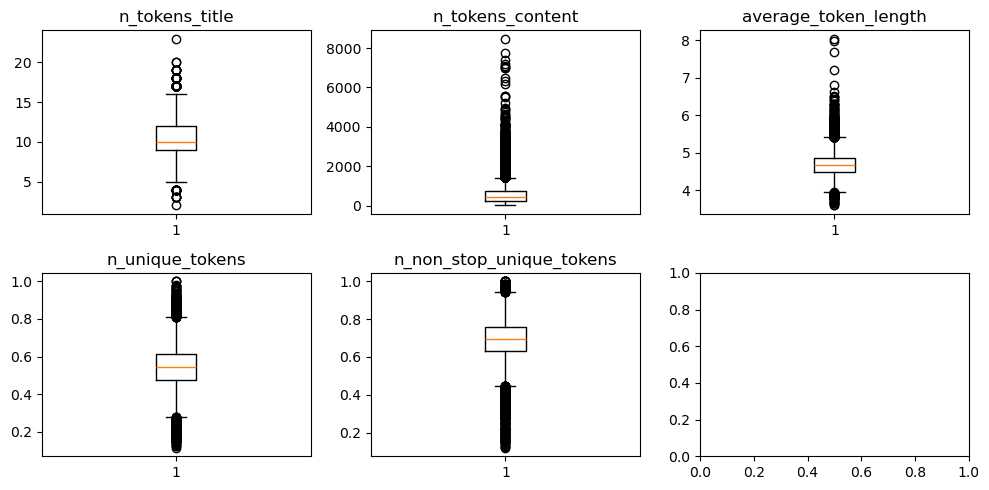

In [289]:
variables = ['n_tokens_title', 'n_tokens_content','average_token_length', 'n_unique_tokens', 'n_non_stop_unique_tokens']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10, 5))
for i, var in enumerate(variables):
    row = i // 3
    col = i % 3
    axes[row, col].boxplot(df[var])
    axes[row, col].set_title(var)
plt.tight_layout()
plt.show()

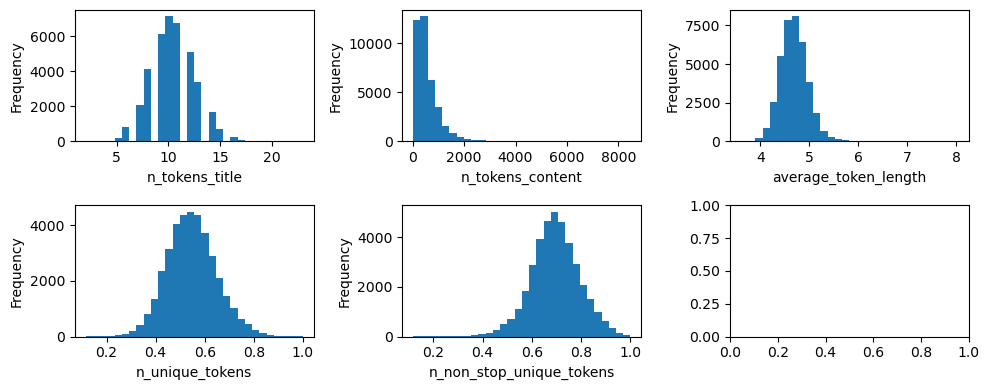

In [290]:
variables = ['n_tokens_title', 'n_tokens_content', 'average_token_length', 'n_unique_tokens', 'n_non_stop_unique_tokens']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10, 4))
for i, var in enumerate(variables):
    axes[i // 3, i % 3].hist(df[var], bins=30, label=f'{var}')
    axes[i // 3, i % 3].set_xlabel(var)
    axes[i // 3, i % 3].set_ylabel('Frequency')
plt.tight_layout()
plt.show()

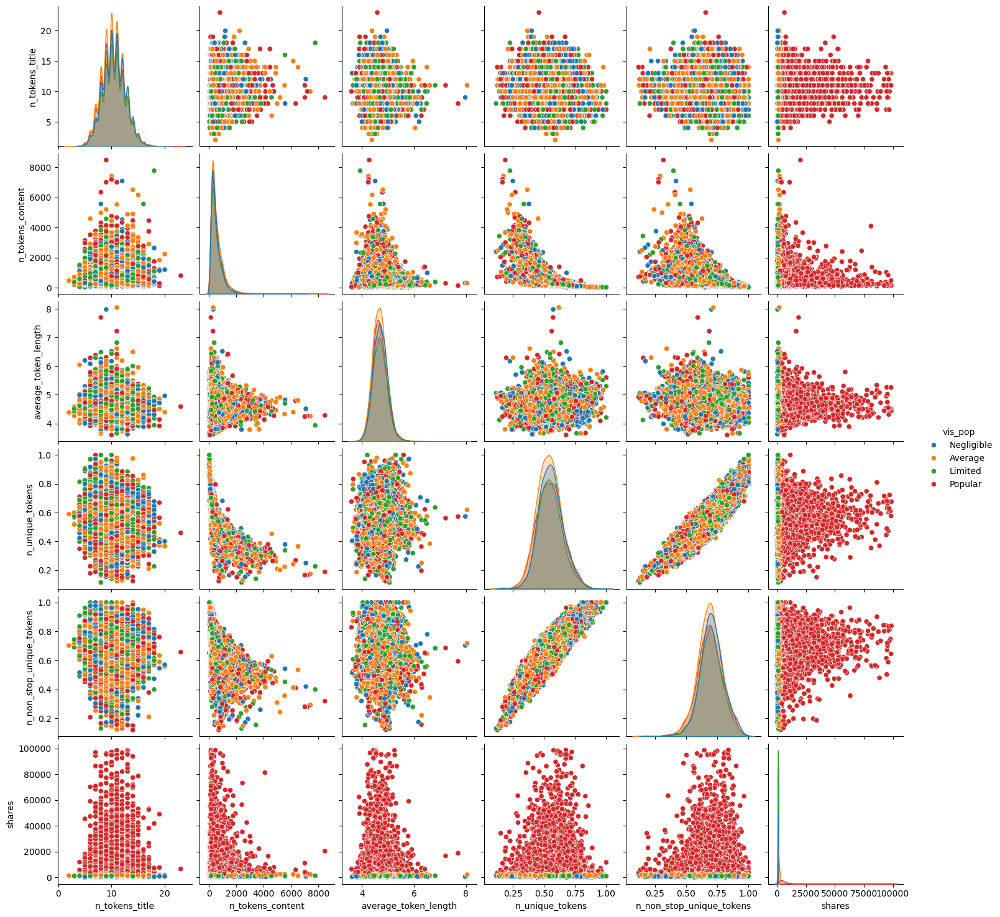

In [291]:
sns.pairplot(df[df['shares'] < 100000], vars = variables + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

<Axes: xlabel='vis_pop', ylabel='n_non_stop_unique_tokens'>

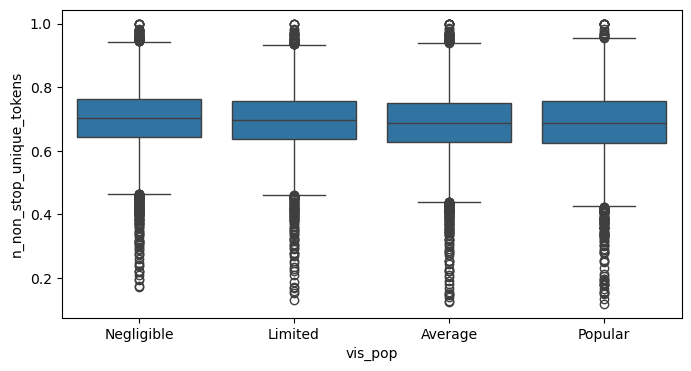

In [211]:
plt.figure(figsize=(8, 4))
sns.boxplot(x = 'vis_pop', y = 'n_non_stop_unique_tokens', data = df, order = popularity_order)

* n_token_title: there is an observable trend. Titles of popular articles generally consist of 5 to 15 words.
* n_tokens_content: there is a clear relationship with shares – the lower the value, the higher the chances of being popular. Mostly less than 2000 words.
* average_token_length: There is an observable trend. Popular articles have an average of 4 to 5 characters per word.
* n_unique_tokens:  There is an observable trend. Popular articles generally use 40% to 70% unique words.
* n_non_stop_words: This feature is dropped due to providing no useful info.
* n_non_stop_unique_tokens: No special relationship observed.

#### Links
variable names: num_hrefs, num_self_hrefs

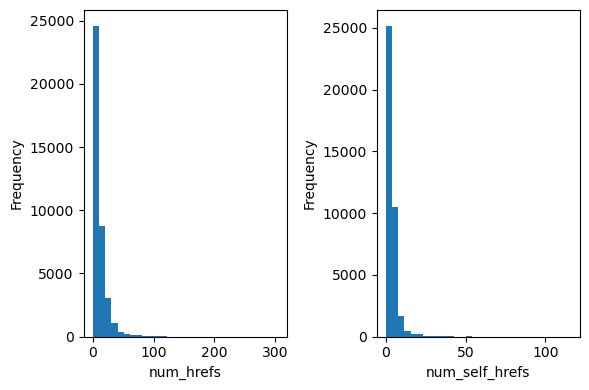

In [335]:
variables = ['num_hrefs', 'num_self_hrefs']
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(6, 4))
for i, var in enumerate(variables):
    axes[i].hist(df[var], bins=30, label=f'{var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel('Frequency')
plt.tight_layout()
plt.show()

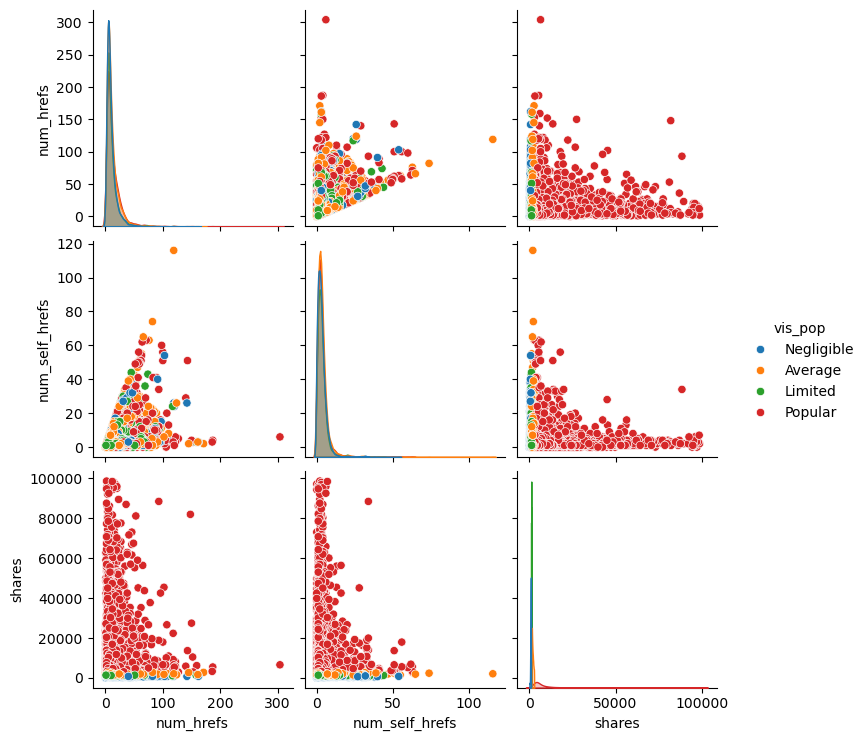

In [330]:
variables = ['num_hrefs', 'num_self_hrefs']
sns.pairplot(df[df['shares'] < 100000], vars = variables + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

There is an observable trend for both features; As the value drops, shares start rising.
* num_hrefs: There is an observable trend; Popular articles typically have fewer than 50.
* num_self_hrefs: There is an observable trend; Popular articles generally have fewer than 15.

#### Referenced Articles
variable names: self_reference_min_shares, self_reference_max_shares, self_reference_avg_shares

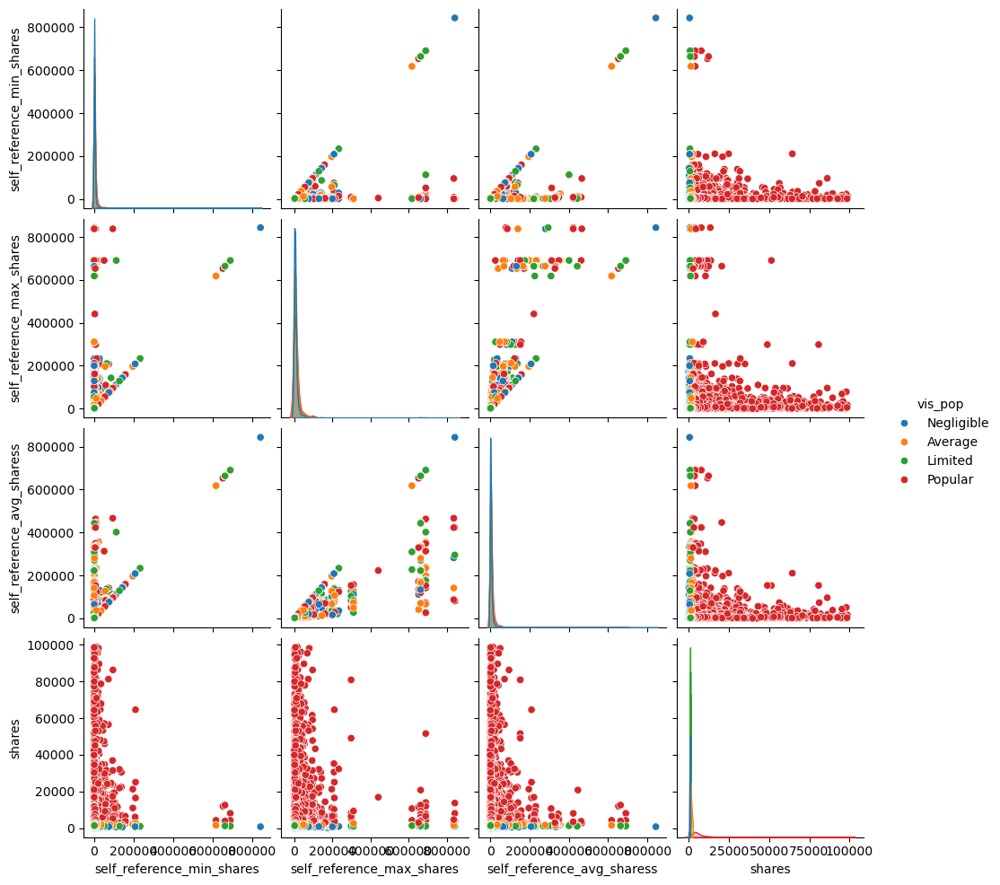

In [318]:
variables = ['self_reference_min_shares', 'self_reference_max_shares', 'self_reference_avg_sharess']
sns.pairplot(df[df['shares'] < 100000], vars = variables + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

There is an observable trend for all three features; As the value drops, shares start rising.

#### Digital Media
variable names: num_imgs, num_videos

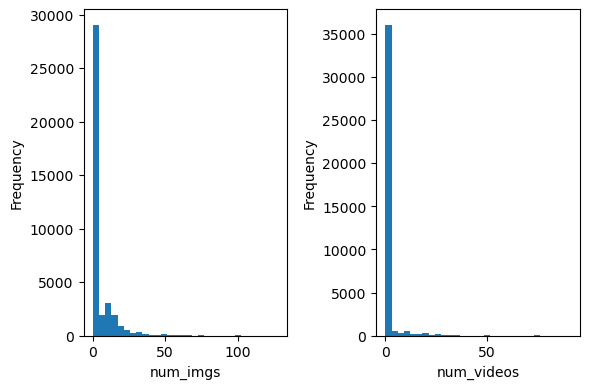

In [336]:
variables = ['num_imgs', 'num_videos']
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(6, 4))
for i, var in enumerate(variables):
    axes[i].hist(df[var], bins=30, label=f'{var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel('Frequency')
plt.tight_layout()
plt.show()

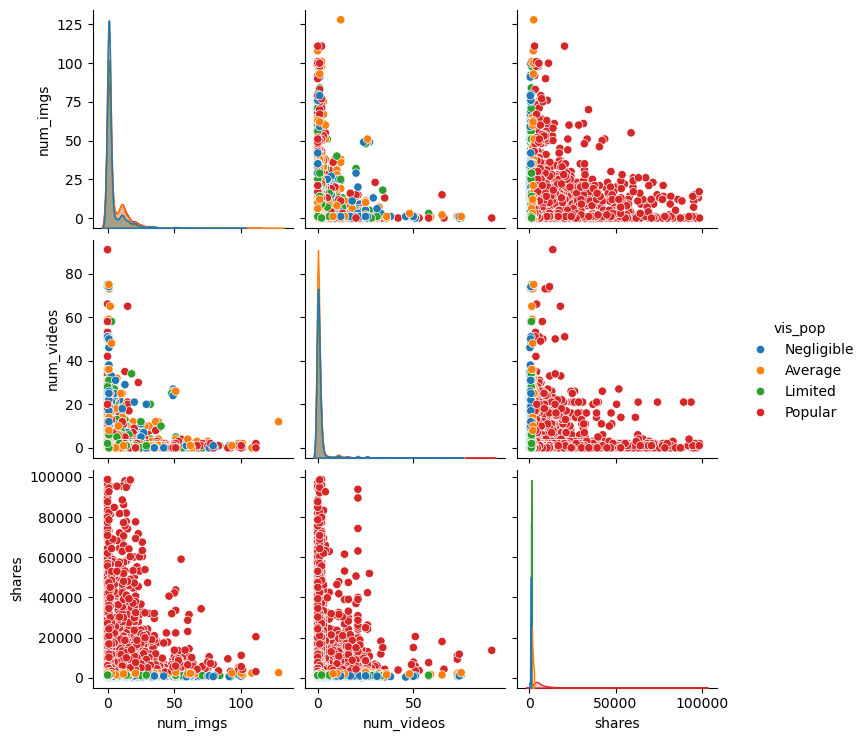

In [337]:
sns.pairplot(df[df['shares'] < 100000], vars = variables + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

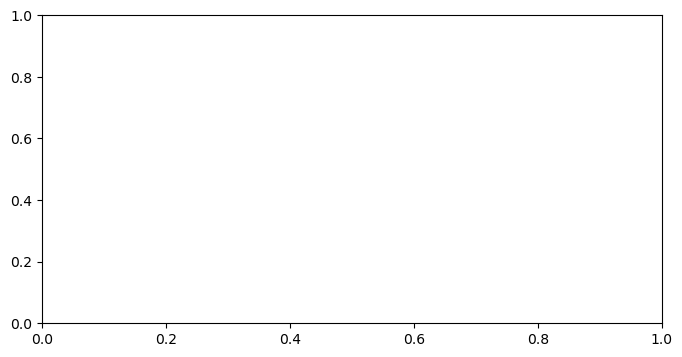

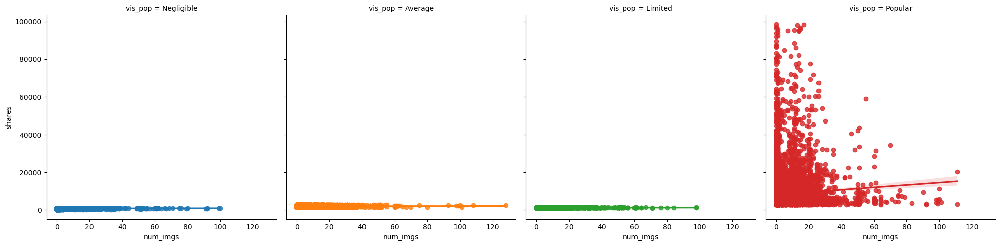

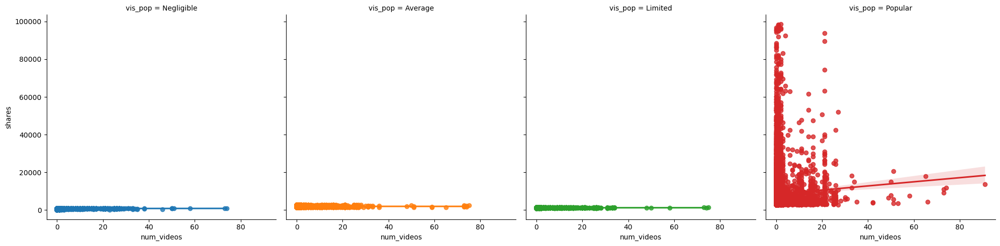

In [347]:
fig, axes = plt.subplots(figsize=(8, 4))
for i, var in enumerate(variables):
    sns.lmplot(x=var, y='shares', hue='vis_pop', data=df[df['shares'] < 100000], col='vis_pop')
plt.tight_layout()
plt.show()

There is an observable trend for both features; As the value drops, shares start rising.
* num_imgs: There is an observable trend; Popular articles typically have fewer than 40.
* num_self_videos: There is an observable trend; Popular articles generally have fewer than 25.

#### Publication Time
variable names: weekdays, is_weekend

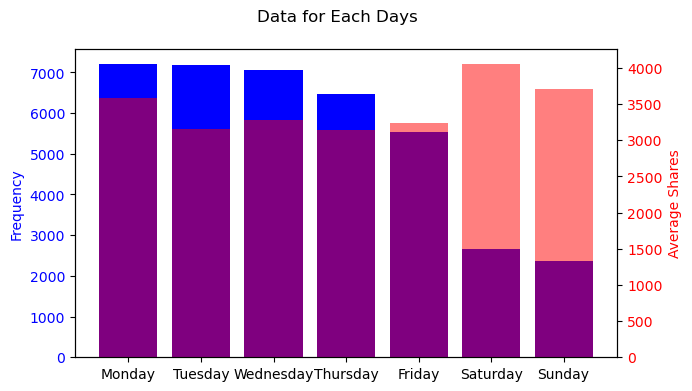

In [316]:
# weekdays

fig, ax1 = plt.subplots(figsize=(7, 4))

weekday_counts = df['weekdays'].value_counts()
ave_share_counts = df.groupby('weekdays')['shares'].sum() / weekday_counts

# Sort weekdays in the desired order
desired_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ave_share_counts = ave_share_counts.reindex(desired_order)

# Plotting 'Frequency' on the primary y-axis
color_freq = 'b'
ax1.bar(ave_share_counts.index, weekday_counts, color=color_freq, label='Frequency')
ax1.set_ylabel('Frequency', color=color_freq)
ax1.tick_params(axis='y', labelcolor=color_freq)

# Creating a secondary y-axis for 'Average Shares'
ax2 = ax1.twinx()
color_shares = 'r'
ax2.bar(ave_share_counts.index, ave_share_counts, alpha=0.5, color=color_shares, label='Average Shares')
ax2.set_ylabel('Average Shares', color=color_shares)
ax2.tick_params(axis='y', labelcolor=color_shares)

fig.suptitle('Data for Each Days')
plt.show()

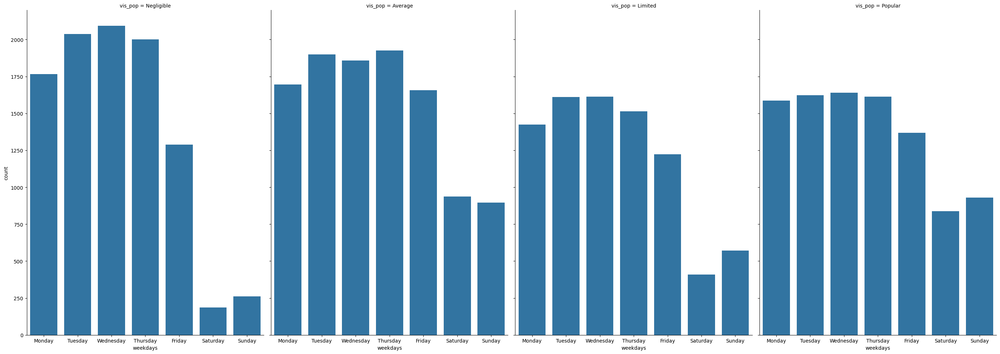

In [317]:
sns.catplot(x='weekdays', col="vis_pop", data=df, kind="count", height=10, aspect=.7)

* While publications during the weekend are significantly fewer than on weekdays, articles published on weekend earned higher average shares. 
* Popular articles are published more on Wednesday, followed by Tuesday, Thursday, and Monday. There is a lower chance for those published on the weekend to be popular.

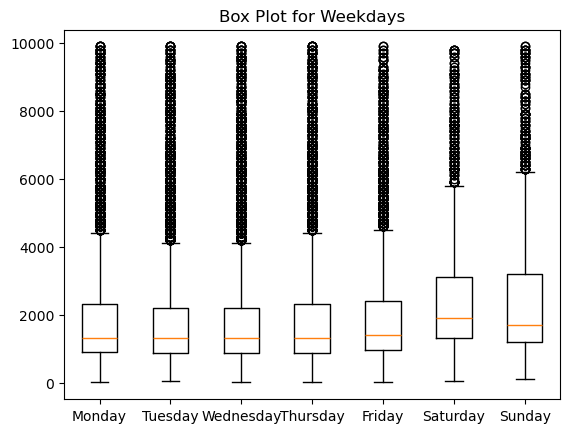

In [322]:
# df_reduced = df[df['shares'] < 100000]
df_reduced = df[df['shares'] < 10000]
plt.boxplot([df_reduced[df_reduced['weekdays'] == category]['shares'] for category in df_reduced['weekdays'].unique()],
            labels=df_reduced['weekdays'].unique())
plt.title('Box Plot for Weekdays')
plt.show()

There is insignificant difference during Monday to Friday, is it possible to reduce the levels?

### One-way ANOVA

In [323]:
import pingouin as pg

pg.anova(dv='shares', between='weekdays', data=df, detailed=True)

,Source,SS,DF,MS,F,p-unc,np2
0,weekdays,2.566985e+09,6,4.278308e+08,3.188195,0.003957,0.000497
1,Within,5.160361e+12,38455,1.341922e+08,NaN,NaN,NaN


At least one pair of mean are significant different.

Let's check the multiple comparison!

#### Pairwise t-test

In [324]:
pg.pairwise_tests(dv='shares', between='weekdays', padjust='bonf', data=df)

,Contrast,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,weekdays,Friday,Monday,False,True,-1.695621,10291.494166,two-sided,0.089988,1.000000,bonf,0.087,-0.029757
1,weekdays,Friday,Saturday,False,True,-2.620079,3003.796668,two-sided,0.008835,0.185539,bonf,0.849,-0.079898
2,weekdays,Friday,Sunday,False,True,-2.968642,6594.489913,two-sided,0.003002,0.063041,bonf,2.156,-0.064098
3,weekdays,Friday,Thursday,False,True,0.579413,12532.846472,two-sided,0.562321,1.000000,bonf,0.024,0.010188
4,weekdays,Friday,Tuesday,False,True,0.510079,12646.704470,two-sided,0.610005,1.000000,bonf,0.023,0.008907
5,weekdays,Friday,Wednesday,False,True,-0.258461,11518.592674,two-sided,0.796056,1.000000,bonf,0.021,-0.004296
6,weekdays,Monday,Saturday,False,True,-1.346652,4261.140710,two-sided,0.178164,1.000000,bonf,0.067,-0.032143
7,weekdays,Monday,Sunday,False,True,-0.545242,9120.922125,two-sided,0.585600,1.000000,bonf,0.03,-0.009300
8,weekdays,Monday,Thursday,False,True,2.092532,10942.661261,two-sided,0.036414,0.764693,bonf,0.173,0.036655
9,weekdays,Monday,Tuesday,False,True,2.039787,11007.607097,two-sided,0.041395,0.869302,bonf,0.154,0.035688


There are several pairs can be group together, since the corresponding p-unc < significance level 0.05.

Let's check how robust it is for the result.

Residual Analysis
1. Normality test
2. Homogeneity of variance
3. Independence

ShapiroResult(statistic=0.15414714813232422, pvalue=0.0)


/Users/chenshuxi/miniconda3/envs/Revibing_research/lib/python3.11/site-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


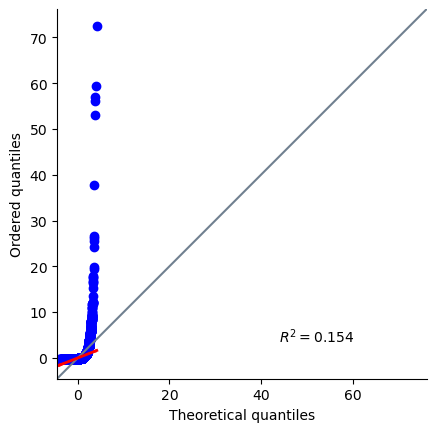

In [325]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
formula = 'shares ~ weekdays'
model = ols(formula, data=df).fit()
res = model.resid

#Shapiro-Wilk test with scipy
from scipy.stats import shapiro
print(shapiro(res))

# QQ plot
ax = pg.qqplot(res, dist='norm')
sns.despine()

In [326]:
pg.homoscedasticity(data=df, dv='shares', group='weekdays', center = "mean").round(2)

,W,pval,equal_var
levene,3.24,0.0,False


Not normal. Not equal variance. -> The result is not robust enough!

**I decided not to group those levels. which means the "is_weekend" variable will not be included in the following analysis and will be dropped.** 

In [327]:
df.drop(labels=['is_weekend'], axis = 1, inplace=True)

#### Keywords
variable names: num_keywords, kw_min_min, kw_max_min, kw_avg_min, kw_min_max, kw_max_max, kw_avg_max, kw_min_avg, kw_max_avg, kw_avg_avg, channels

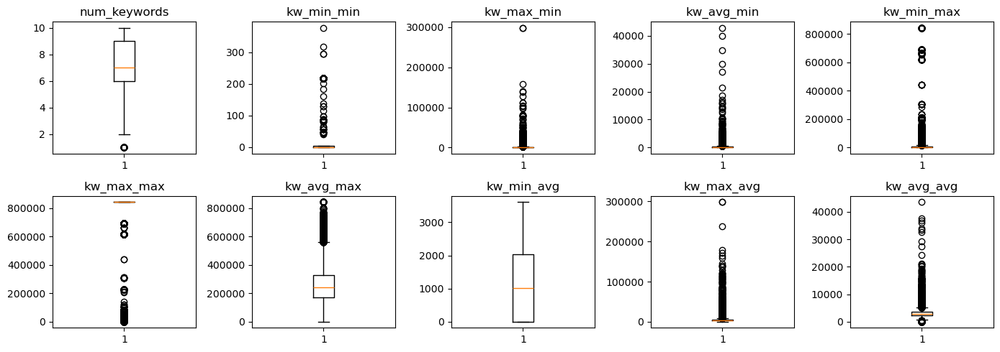

In [247]:
variables = ['num_keywords', 'kw_min_min', 'kw_max_min', 'kw_avg_min', 'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg', 'kw_avg_avg']
fig, axes = plt.subplots(nrows = 2, ncols = 5, figsize = (14,5))
for i, var in enumerate(variables):
    row = i // 5
    col = i % 5
    axes[row, col].boxplot(df[var])
    axes[row, col].set_title(var)
plt.tight_layout()
plt.show()

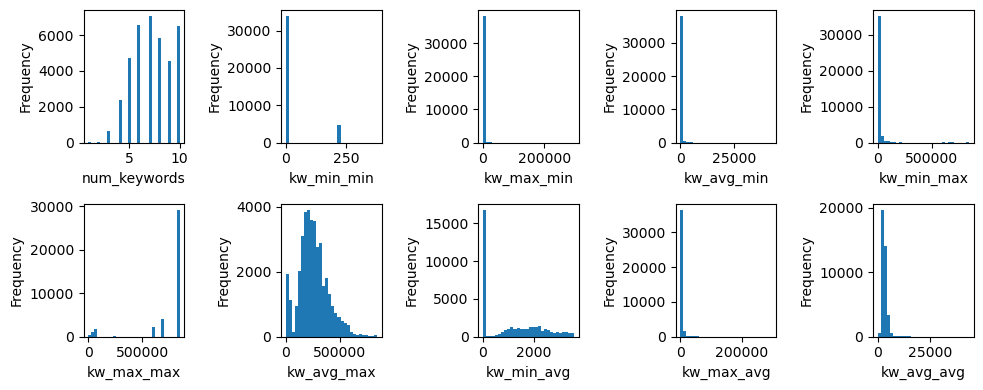

In [251]:
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(10, 4))
for i, var in enumerate(variables):
    row = i // 5
    col = i % 5
    axes[row, col].hist(df[var], bins=30, label=f'{var}')
    axes[row, col].set_xlabel(var)
    axes[row, col].set_ylabel('Frequency')
plt.tight_layout()
plt.show()

In [274]:
df['kw_min_min'].describe()
# df['kw_max_min'].describe()
# df['kw_avg_min'].describe()
# df['kw_min_max'].describe()
# df['kw_max_max'].describe()
# df['kw_avg_max'].describe()
# df['kw_min_avg'].describe()
# df['kw_max_avg'].describe()
# df['kw_avg_avg'].describe()

count    38462.000000
mean        26.708907
std         70.278986
min         -1.000000
25%         -1.000000
50%         -1.000000
75%          4.000000
max        377.000000
Name: kw_min_min, dtype: float64

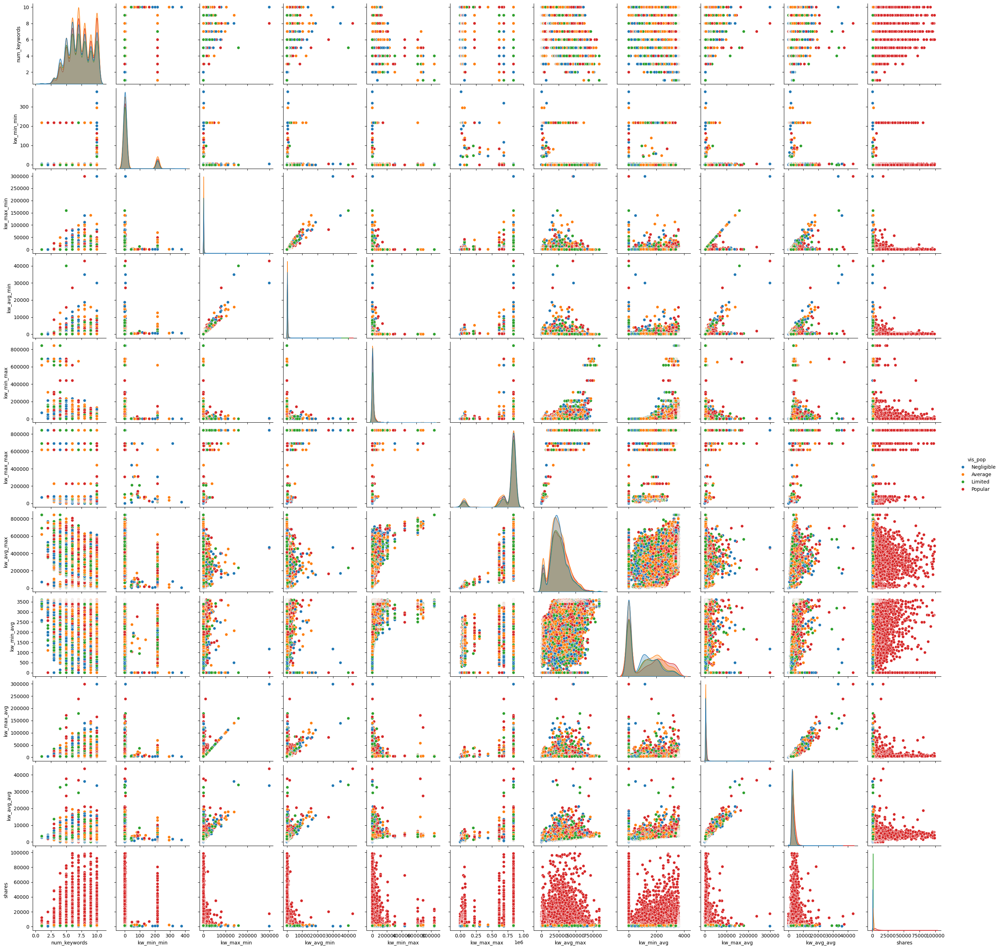

In [280]:
sns.pairplot(df[df['shares'] < 100000], vars = variables + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

* num_keywords:  The hypothesis is correct - the more keyword tags used, the more popular an article. This is because the algorithm better understands an article with more keywords and pushes it more to readers. It is recommended to have a value above 6.
* kw_min_min: Ups and downs.
* kw_max_min: As the value drops, shares start rising. A high value doesn't help the shares.
* kw_avg_min: As the value drops, shares start rising. A high value doesn't help the shares.
* kw_min_max: As the value drops, shares start rising. A high value doesn't help the shares.
* kw_max_max: Ups and downs.
* kw_avg_max: No particular trend. It doesn't matter whether the value is low or high.
* kw_min_avg: No particular trend. It doesn't matter whether the value is low or high.
* kw_max_avg: As the value drops, shares start rising. A high value doesn't help the shares.
* kw_avg_avg: As the value drops, shares start rising. A high value doesn't help the shares.

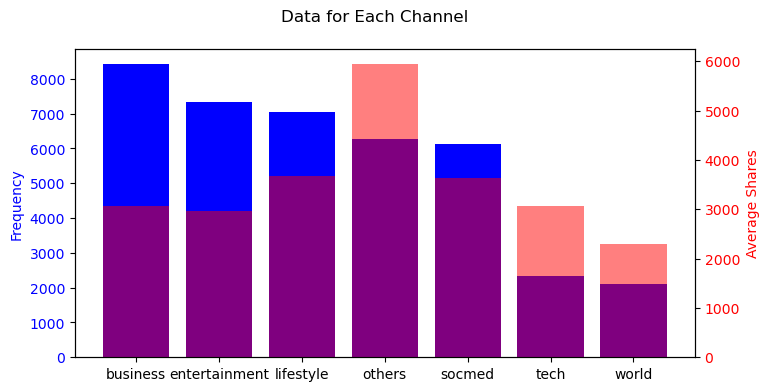

In [192]:
# channels

fig, ax1 = plt.subplots(figsize=(8, 4))

weekday_counts = df['channels'].value_counts()
ave_share_counts = df.groupby('channels')['shares'].sum() / weekday_counts

# Plotting 'Frequency' on the primary y-axis
color_freq = 'b'
ax1.bar(ave_share_counts.index, weekday_counts, color=color_freq, label='Frequency')
ax1.set_ylabel('Frequency', color=color_freq)
ax1.tick_params(axis='y', labelcolor=color_freq)

# Creating a secondary y-axis for 'Average Shares'
ax2 = ax1.twinx()
color_shares = 'r'
ax2.bar(ave_share_counts.index, ave_share_counts, alpha=0.5, color=color_shares, label='Average Shares')
ax2.set_ylabel('Average Shares', color=color_shares) 
ax2.tick_params(axis='y', labelcolor=color_shares)

fig.suptitle('Data for Each Channel')
plt.show()

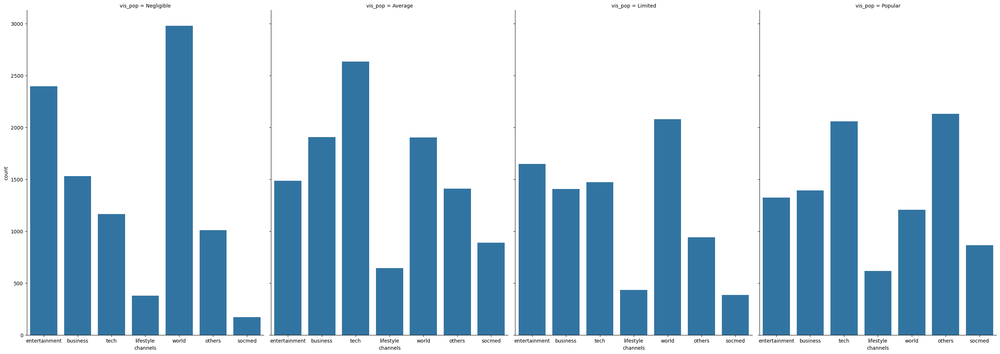

In [328]:
sns.catplot(x='channels', col="vis_pop", data=df, kind="count", height=10, aspect=.7)

* "Others," "Tech," and "World" channels surpass the corresponding number of publications. They tend to receive more shares per article compared to the number of articles published in other channels.
* Popular articles belong to the "others" channel, with "Tech" following closely. "Business", "entertainment" and "World" rank third, but they seems to be persistent in all popularity types, meaning they may not be the popular choices for publishing articles.

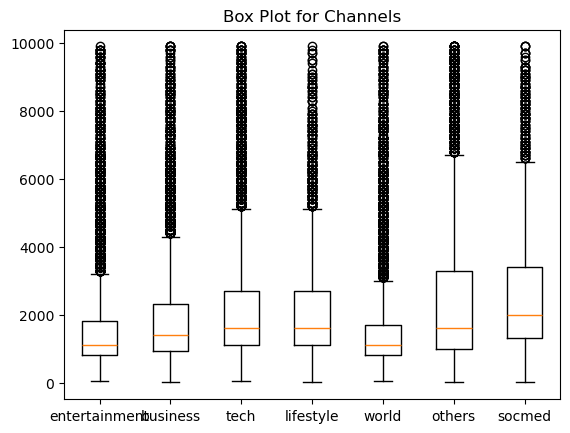

In [329]:
# df_reduced = df[df['shares'] < 100000]
df_reduced = df[df['shares'] < 10000]

plt.boxplot([df_reduced[df_reduced['channels'] == category]['shares'] for category in df_reduced['channels'].unique()],
            labels=df_reduced['channels'].unique())
plt.title('Box Plot for Channels')
plt.show()

It suggests a significant difference among all levels; needless to reduce the levels.

#### NLP
variable names: LDA_00, LDA_01, LDA_02, LDA_03, LDA_04, title_subjectivity, title_sentiment_polarity, global_subjectivity, global_sentiment_polarity, global_rate_positive_words, global_rate_negative_words, rate_positive_words, rate_negative_words, avg_positive_polarity, min_positive_polarity, max_positive_polarity, avg_negative_polarity, min_negative_polarity, max_negative_polarity, abs_title_subjectivity, abs_title_sentiment_polarity

In [293]:
lda_vars = ['LDA_00', 'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04']
sub_pol_vars = ['title_subjectivity', 'title_sentiment_polarity', 'global_subjectivity', 'global_sentiment_polarity', 'abs_title_subjectivity', 'abs_title_sentiment_polarity']
rate_sentiment_vars = ['global_rate_positive_words', 'global_rate_negative_words', 'rate_positive_words', 'rate_negative_words']
pol_vars = ['avg_positive_polarity', 'min_positive_polarity', 'max_positive_polarity', 'avg_negative_polarity', 'min_negative_polarity', 'max_negative_polarity']

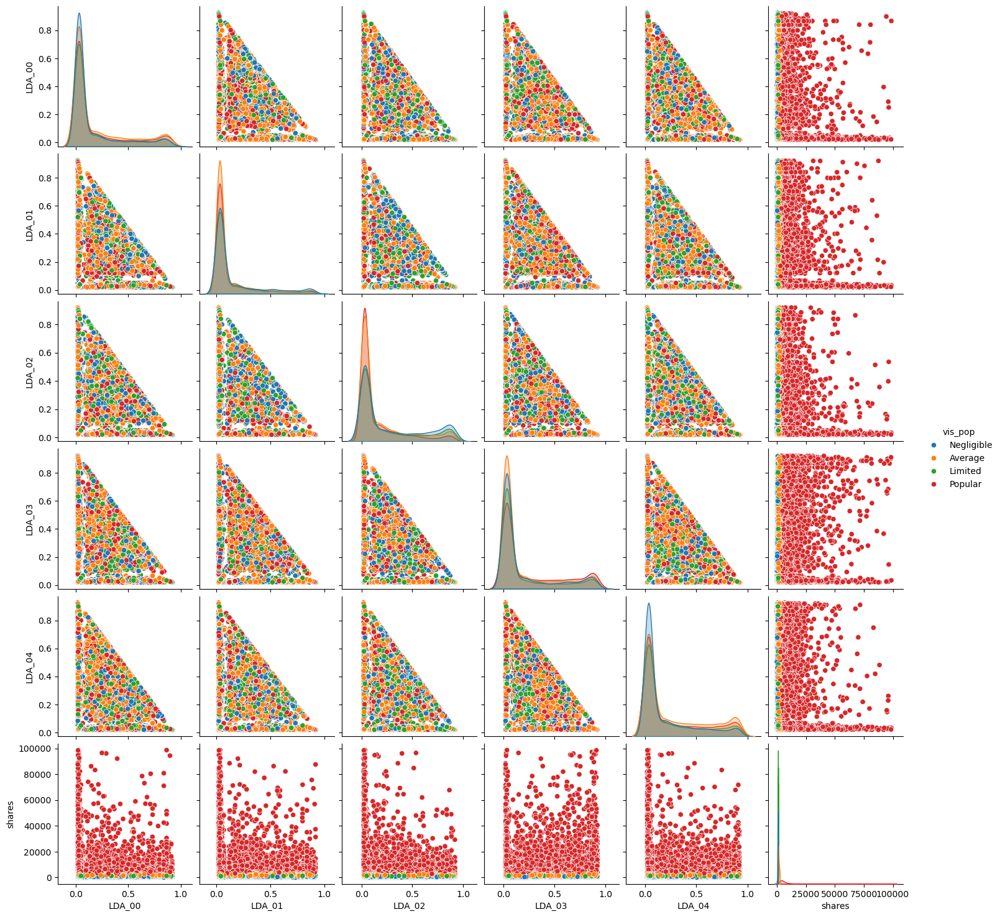

In [315]:
# relationship between lda_vars

sns.pairplot(df[df['shares'] < 100000], vars = lda_vars + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

There is no observable trend between LDA and shares. However, the relationship between LDA topics themselves is obvious.

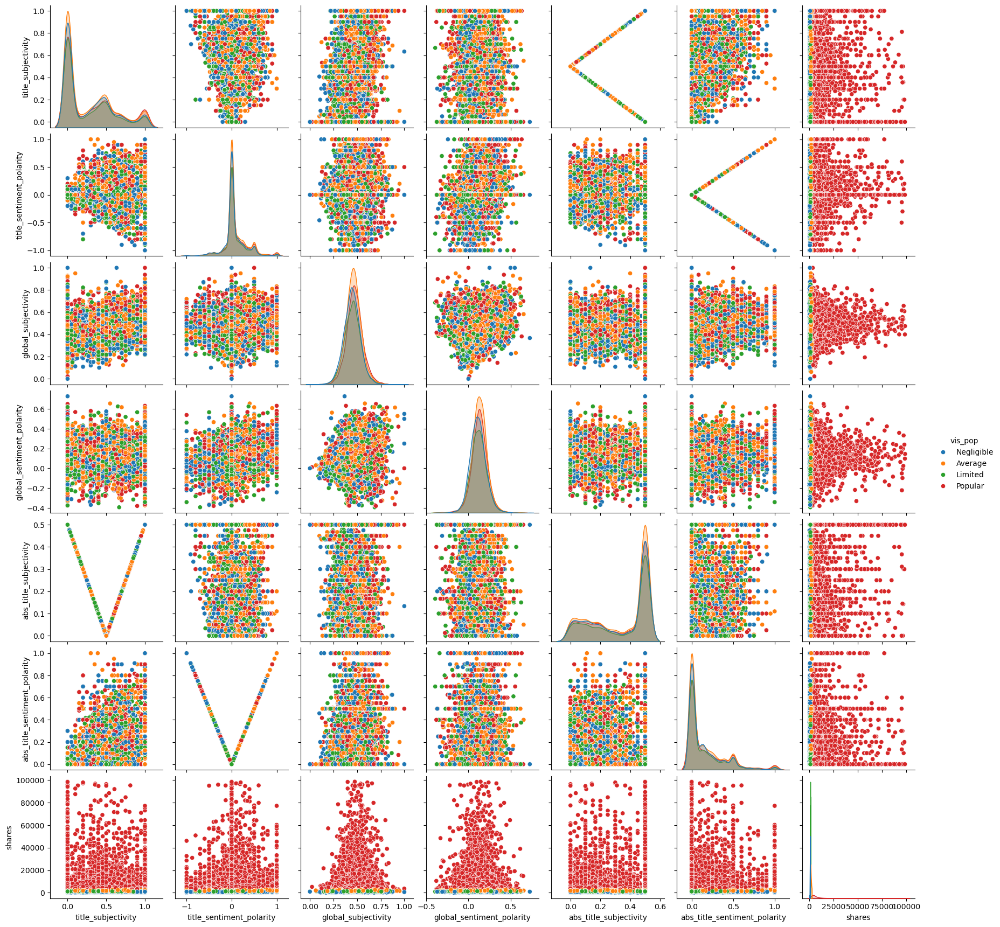

In [309]:
# relationship between sub_pol_vars

sns.pairplot(df[df['shares'] < 100000], vars = sub_pol_vars + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

<Figure size 800x400 with 0 Axes>

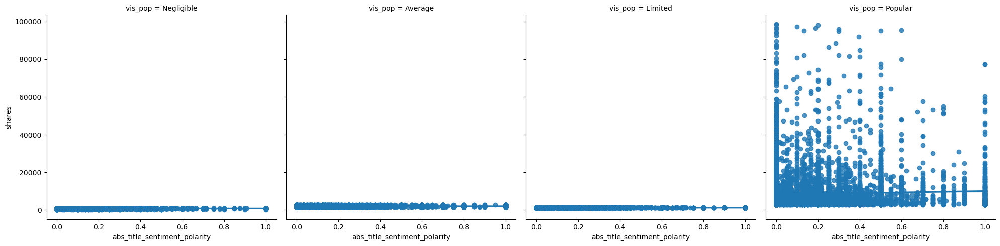

In [314]:
plt.figure(figsize=(8, 4))
sns.lmplot(x='abs_title_sentiment_polarity', y='shares', col='vis_pop', data=df[df['shares'] < 100000])

* title_subjectivity: No special relationship is observed. Hypothesis is not correct.
* title_sentiment_polarity: There is an observable trend; titles of popular articles tend to have a polarity close to zero. Either the more positive or negative the titles, the less popular the articles.
* global_subjectivity: There is an observable trend; the more closer to center value 0.5, the popular of the articles.
* global_sentiment_polarity: There is an observable trend; the more closer to center value 0.13, the popular of the articles.
* abs_title_subjectivity: No special relationship is observed. 
* abs_title_sentiment_polarity: No special relationship is observed. 

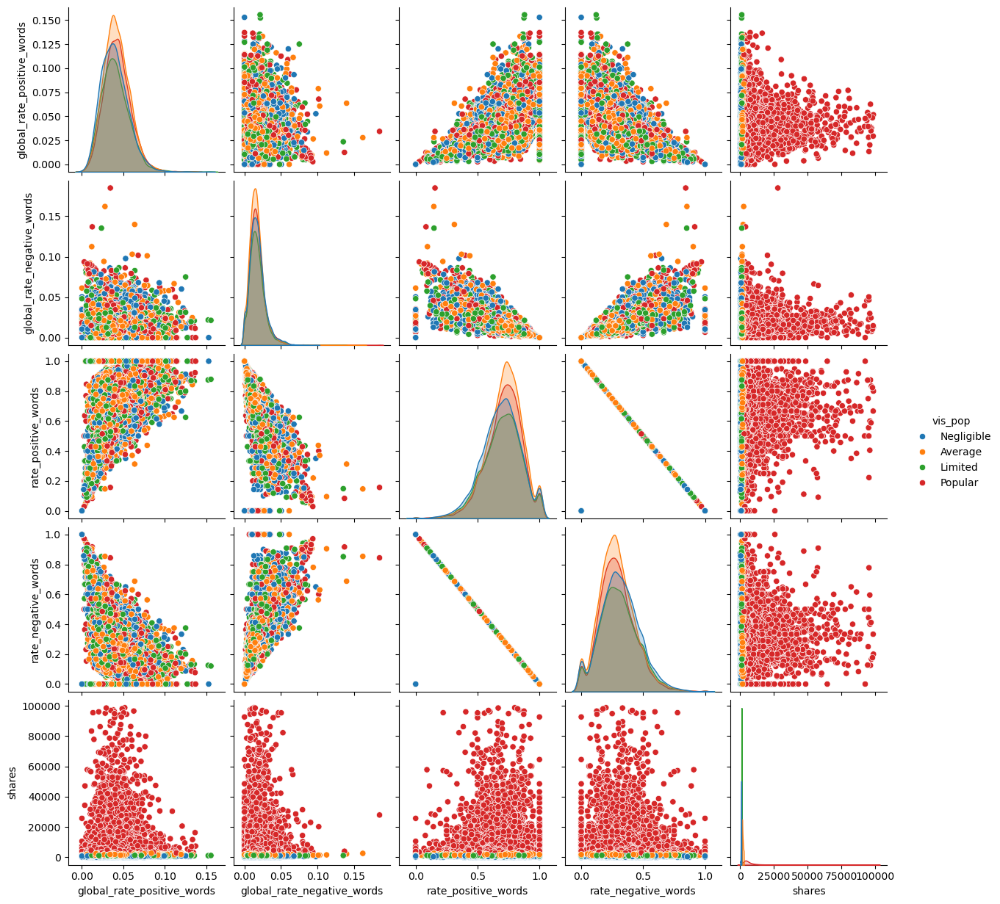

In [297]:
# relationship between rate_sentiment_vars

sns.pairplot(df[df['shares'] < 100000], vars = rate_sentiment_vars + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

The linear relationship between rate_positive_words and rate_negative_words is as expected normal.

* global_rate_positive_words: There is an observable trend; Popular articles generally use 2% to 7% positive words.
* global_rate_negative_words: There is an observable trend; As the value drops, shares start rising. It is recommended to be below 40%.
* rate_positive_words:  No special relationship is observed. Most articles tends to fall between 0.3 to 1.
* rate_negative_words: No special relationship is observed. Most articles tends to fall between 0 to 0.8.

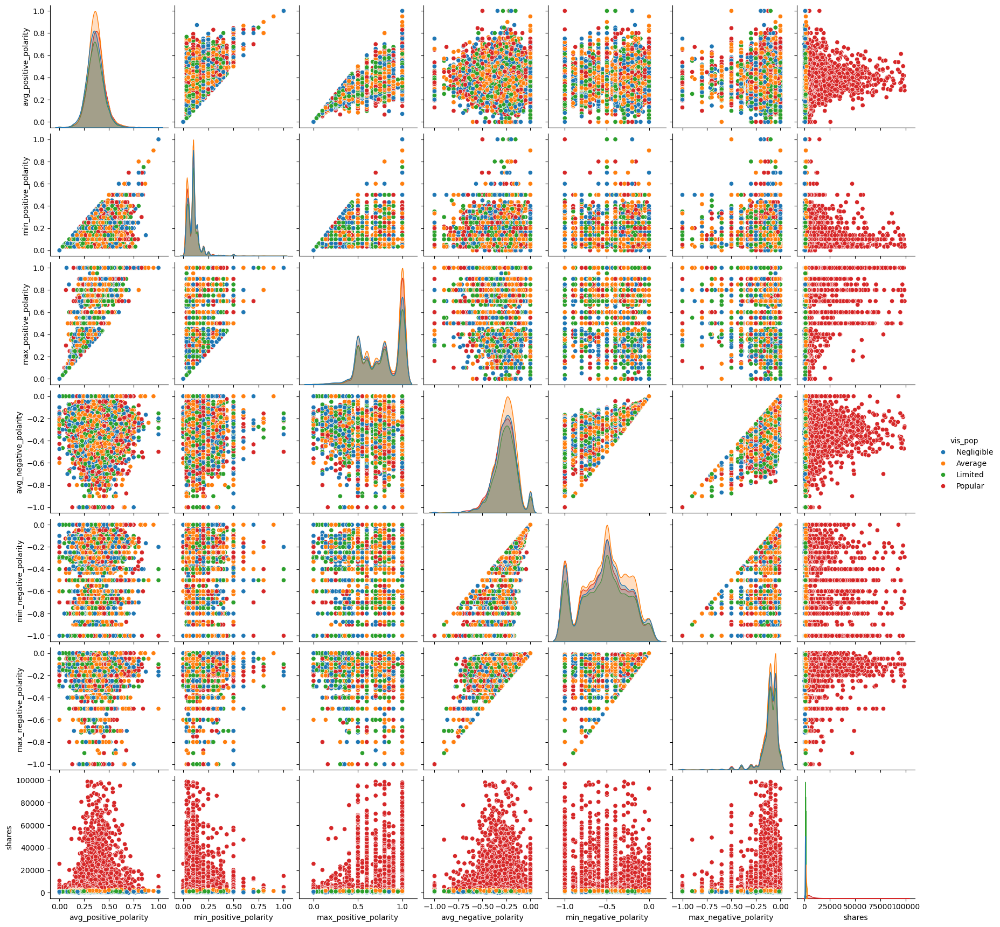

In [298]:
# relationship between pol_vars

sns.pairplot(df[df['shares'] < 100000], vars = pol_vars + ['shares'], hue = 'vis_pop', diag_kind = 'kde')

<Axes: xlabel='vis_pop', ylabel='max_positive_polarity'>

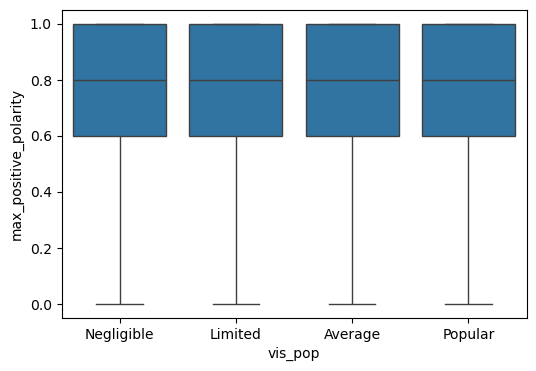

In [305]:
plt.figure(figsize=(6, 4))
sns.boxplot(x = 'vis_pop', y = 'max_positive_polarity', data = df[df['shares'] < 100000], order = popularity_order)

There seems to be a slight trend between 'max_positive_polarity', 'max_negative_polarity', and 'shares'. Let's check if this is true.

<Figure size 800x400 with 0 Axes>

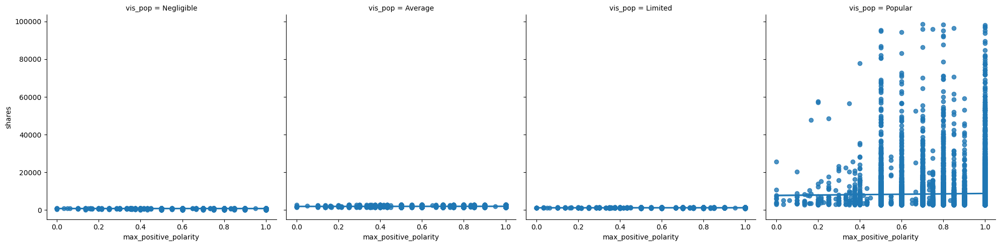

In [306]:
plt.figure(figsize=(8, 4))
sns.lmplot(x='max_positive_polarity', y='shares', col='vis_pop', data=df[df['shares'] < 100000])

<Axes: xlabel='vis_pop', ylabel='max_negative_polarity'>

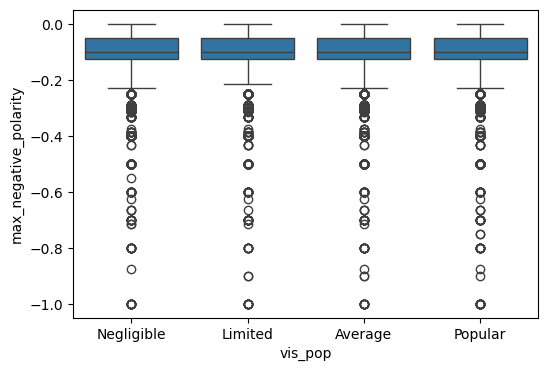

In [308]:
plt.figure(figsize=(6, 4))
sns.boxplot(x = 'vis_pop', y = 'max_negative_polarity', data = df[df['shares'] < 100000], order = popularity_order)

<Figure size 800x400 with 0 Axes>

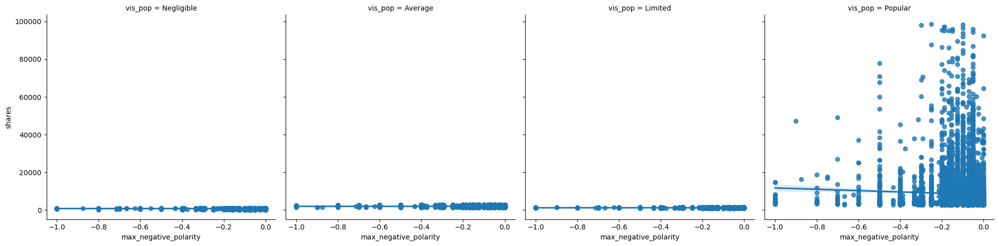

In [307]:
plt.figure(figsize=(8, 4))
sns.lmplot(x='max_negative_polarity', y='shares', col='vis_pop', data=df[df['shares'] < 100000])

* avg_positive_polarity: There is an observable trend; Popular articles on average is 0.2 to 0.6 positive.
* min_positive_polarity: There is an observable trend; As the value drops, shares start rising.
* max_positive_polarity: No special relationship is observed.
* avg_negative_polarity: No special relationship is observed.
* min_negative_polarity: No special relationship is observed. 
* max_negative_polarity: No special relationship is observed. 

#### Interaction Effect

* Analyze how the distribution of article types varies across different days of the week and channels. (Channel and Day)

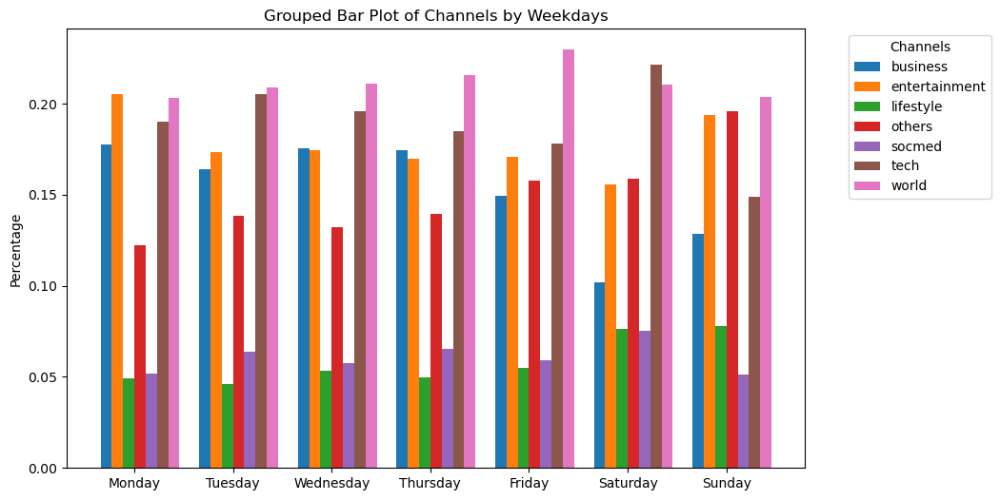

In [350]:
grouped_data = df.groupby(['weekdays', 'channels']).size().unstack(fill_value=0)
# Calculate the channel percentage for each day
df_percentage = grouped_data.div(grouped_data.sum(axis=1), axis=0)

desired_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_percentage = df_percentage.reindex(desired_order)

fig, ax = plt.subplots(figsize=(10, 6))
num_channels = len(df_percentage.columns)
num_weekdays = len(df_percentage)

# Calculate the total width for each group of bars
total_width = 0.8  
bar_width = total_width / num_channels

channels = df_percentage.columns
for i, channel in enumerate(channels):
    positions = [p + i * bar_width for p in range(num_weekdays)]
    ax.bar(positions, df_percentage[channel], width=bar_width, label=channel, align='edge')

ax.set_xticks([p + total_width / 2 - bar_width / 2 for p in range(num_weekdays)])
ax.set_xticklabels(df_percentage.index)
ax.set_ylabel('Percentage')
ax.set_title('Grouped Bar Plot of Channels by Weekdays')
ax.legend(title='Channels', bbox_to_anchor=(1.05, 1), loc='upper left')  # Adjust legend position
plt.show()

1. "Others," "Lifestyle," and "Entertainment" show higher publication rates on weekends, while business articles decrease.
2. Entertainment exhibits increased publication on Sunday and Monday.
3. "World," "Social Media," and "Tech" consistently maintain higher publication rates.

### Two-Way ANOVA
Let's plot the interaction between the publishing channel and the day of the week.

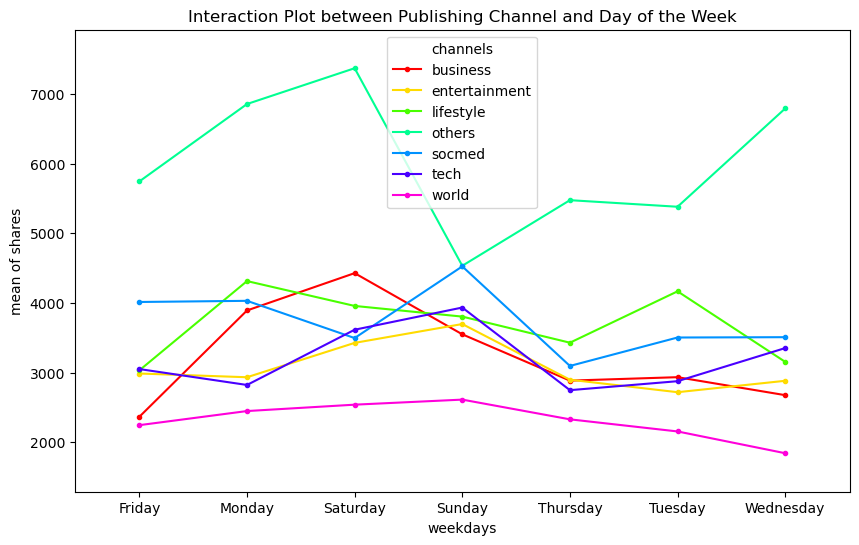

In [351]:
from statsmodels.graphics.factorplots import interaction_plot
fig, ax = plt.subplots(figsize=(10, 6))
interaction_plot(x=df['weekdays'], trace=df['channels'], response=df['shares'], ax=ax)

plt.title('Interaction Plot between Publishing Channel and Day of the Week')
plt.show()

It can be observed that the segments of the lines do not appear parallel, suggesting potential interaction effects.

In [352]:
# Two-way ANOVA
aov = pg.anova(data=df, dv='shares', between=['weekdays', 'channels'])
print(aov)

                Source            SS       DF            MS          F  \
0             weekdays  2.271005e+09      6.0  3.785008e+08   2.848309   
1             channels  4.984184e+10      6.0  8.306974e+09  62.511953   
2  weekdays * channels  5.962193e+09     36.0  1.656165e+08   1.246303   
3             Residual  5.104556e+12  38413.0  1.328862e+08        NaN   

          p-unc       np2  
0  8.968977e-03  0.000445  
1  1.551191e-77  0.009670  
2  1.477204e-01  0.001167  
3           NaN       NaN  


The p-values for weekdays and channels turn out to be less than 0.05 which implies that the means of both the factors possess a statistically significant effect on plant height.

In [353]:
two_way_multi = pg.pairwise_tests(dv='shares', between=['weekdays', 'channels'], padjust='bonf', data=df)
two_way_multi

,Contrast,weekdays,A,B,Paired,Parametric,T,dof,alternative,p-unc,p-corr,p-adjust,BF10,hedges
0,weekdays,-,Friday,Monday,False,True,-1.695621,10291.494166,two-sided,8.998797e-02,1.000000e+00,bonf,0.087,-0.029757
1,weekdays,-,Friday,Saturday,False,True,-2.620079,3003.796668,two-sided,8.835189e-03,1.855390e-01,bonf,0.849,-0.079898
2,weekdays,-,Friday,Sunday,False,True,-2.968642,6594.489913,two-sided,3.001948e-03,6.304090e-02,bonf,2.156,-0.064098
3,weekdays,-,Friday,Thursday,False,True,0.579413,12532.846472,two-sided,5.623213e-01,1.000000e+00,bonf,0.024,0.010188
4,weekdays,-,Friday,Tuesday,False,True,0.510079,12646.704470,two-sided,6.100050e-01,1.000000e+00,bonf,0.023,0.008907
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,weekdays * channels,Wednesday,others,tech,False,True,3.139570,1411.748002,two-sided,1.727023e-03,2.538724e-01,bonf,6.251,0.144309
185,weekdays * channels,Wednesday,others,world,False,True,5.018702,963.461033,two-sided,6.194040e-07,9.105238e-05,bonf,1.191e+04,0.260698
186,weekdays * channels,Wednesday,socmed,tech,False,True,0.285816,1823.976359,two-sided,7.750516e-01,1.000000e+00,bonf,0.065,0.009666
187,weekdays * channels,Wednesday,socmed,world,False,True,6.235672,498.299522,two-sided,9.603643e-10,1.411736e-07,bonf,1.165e+07,0.455741


In [354]:
(abs(two_way_multi['p-unc']) < 0.05).sum()

101

There are 101 pairs can be group together, since the corresponding p-unc < significance level 0.05.

Let's check how robust it is for the result.

Residul analysis

ShapiroResult(statistic=0.17244285345077515, pvalue=0.0)


/Users/chenshuxi/miniconda3/envs/Revibing_research/lib/python3.11/site-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


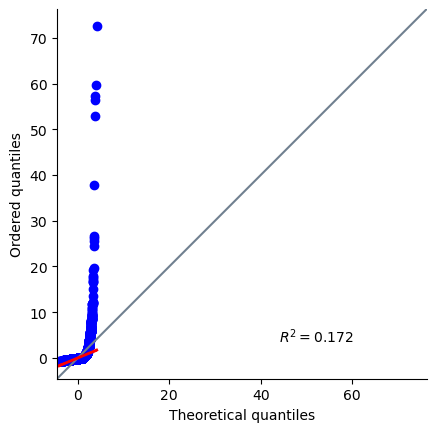

In [355]:
formula = 'shares ~ weekdays + channels + weekdays : channels'
model = ols(formula, data=df).fit()
res = model.resid

#Shapiro-Wilk test with scipy
print(shapiro(res))

# QQ plot
ax = pg.qqplot(res, dist='norm')
sns.despine()

The extreme deviated normality test suggest the non robust result of the two-way ANOVA.

I'll not proceed to the remain residual analysis.

* What the subjectivity and sentiment in different channels and publication days? (Sentimentand and Subjectivity vs. Channel and Day)

/var/folders/zk/tdbf0qq57717wv6g_psgrjk40000gn/T/ipykernel_25903/1333738585.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  grouped_data = df.groupby('channels')['title_subjectivity', 'title_sentiment_polarity', 'global_subjectivity', 'global_sentiment_polarity', 'abs_title_subjectivity',


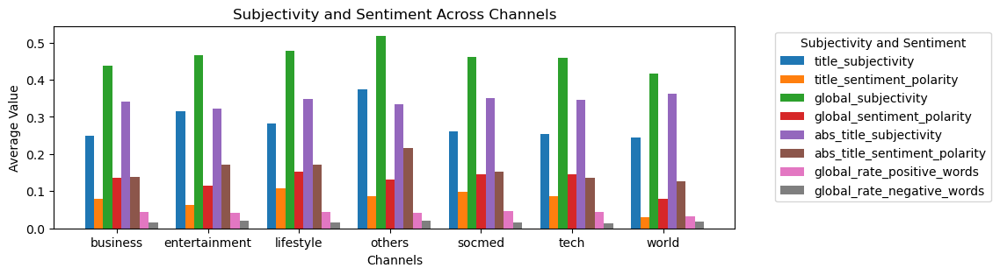

In [356]:
grouped_data = df.groupby('channels')['title_subjectivity', 'title_sentiment_polarity', 'global_subjectivity', 'global_sentiment_polarity', 'abs_title_subjectivity', 
                                      'abs_title_sentiment_polarity', 'global_rate_positive_words', 'global_rate_negative_words'].mean()
fig, ax = plt.subplots(figsize=(10, 3))

num_cols = len(grouped_data.columns)
num_channels = len(grouped_data)

total_width = 0.8  
bar_width = total_width / num_cols
channel = grouped_data.columns
for i, cha in enumerate(channel):
    positions = [p + i * bar_width for p in range(num_channels)]
    ax.bar(positions, grouped_data[cha], width=bar_width, label=cha, align='edge')

ax.set_xticks([p + total_width / 2 - bar_width / 2 for p in range(num_channels)])
ax.set_xticklabels(grouped_data.index)
ax.set_xlabel('Channels')
ax.set_ylabel('Average Value') 
ax.set_title('Subjectivity and Sentiment Across Channels')
ax.legend(title='Subjectivity and Sentiment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

1. "title_subjectivity," "global_subjectivity," and "abs_title_sentiment_polarity" are higher in the Others channel.
2. "title_sentiment_poolarity" and "global_sentiment_polarity" are lower in the World channel.

/var/folders/zk/tdbf0qq57717wv6g_psgrjk40000gn/T/ipykernel_25903/400285479.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  grouped_data = df.groupby('weekdays')['title_subjectivity', 'title_sentiment_polarity', 'global_subjectivity', 'global_sentiment_polarity', 'abs_title_subjectivity',


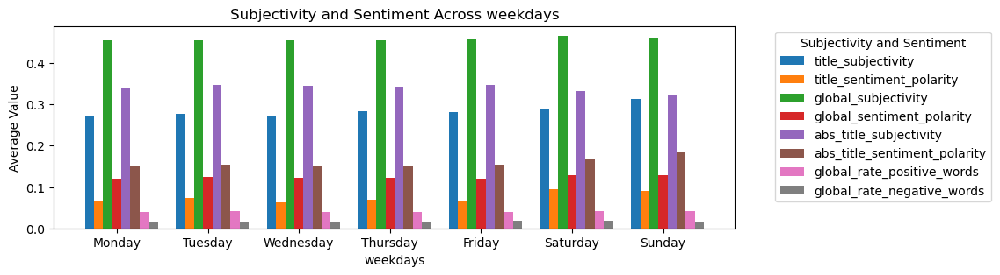

In [358]:
grouped_data = df.groupby('weekdays')['title_subjectivity', 'title_sentiment_polarity', 'global_subjectivity', 'global_sentiment_polarity', 'abs_title_subjectivity', 
                                      'abs_title_sentiment_polarity', 'global_rate_positive_words', 'global_rate_negative_words'].mean()
fig, ax = plt.subplots(figsize=(10, 3))

desired_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
grouped_data = grouped_data.reindex(desired_order)

num_cols = len(grouped_data.columns)
num_weekdays = len(grouped_data)

total_width = 0.8  
bar_width = total_width / num_cols
weekday = grouped_data.columns
for i, day in enumerate(weekday):
    positions = [p + i * bar_width for p in range(num_weekdays)]
    ax.bar(positions, grouped_data[day], width=bar_width, label=day, align='edge')

ax.set_xticks([p + total_width / 2 - bar_width / 2 for p in range(num_weekdays)])
ax.set_xticklabels(grouped_data.index)
ax.set_xlabel('weekdays')
ax.set_ylabel('Average Value') 
ax.set_title('Subjectivity and Sentiment Across weekdays')
ax.legend(title='Subjectivity and Sentiment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

No special patterns or unique observations.

#### Correlation Matrix

/var/folders/zk/tdbf0qq57717wv6g_psgrjk40000gn/T/ipykernel_25903/60988286.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


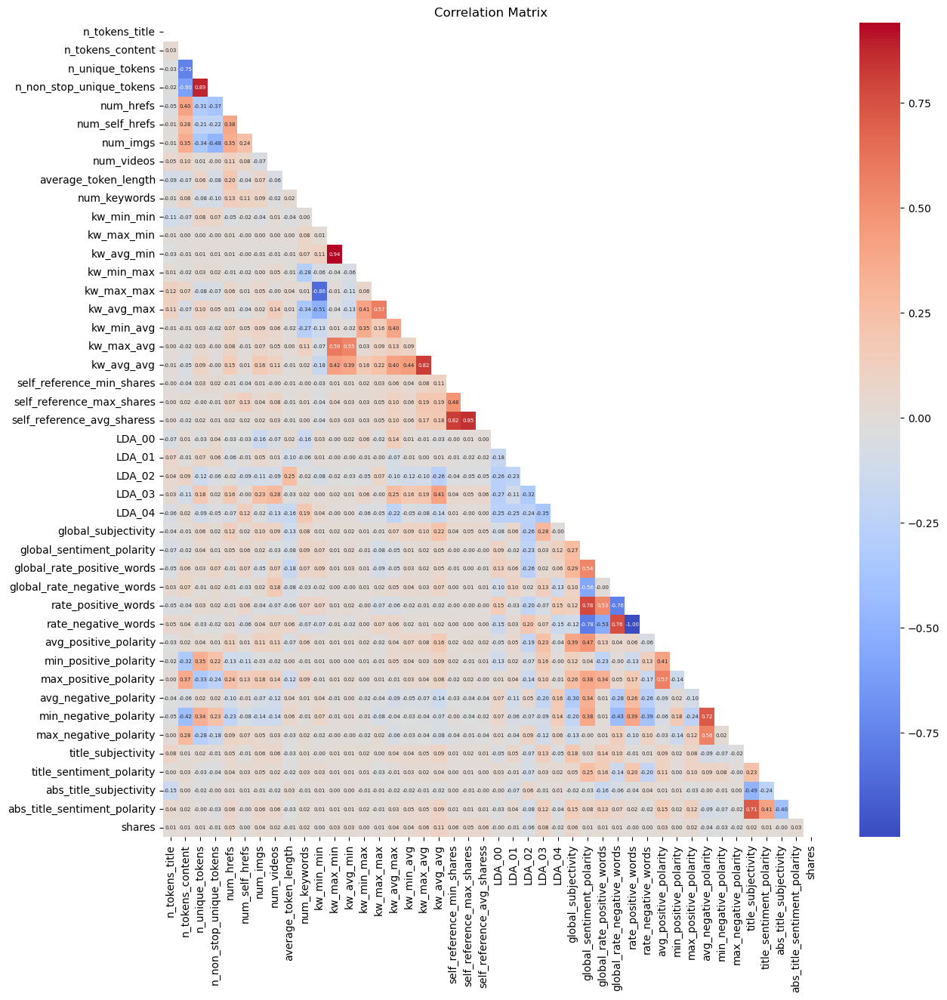

In [364]:
correlation_matrix = df.corr()
# Create a mask to hide the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
plt.figure(figsize=(14,14))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 5}, mask = mask)
plt.title('Correlation Matrix')
plt.show()

The correlation coefficients between various numerical variables and the number of shares are relatively low. 

The low correlation indicates a lower degree of correlation among the variables, suggesting a lower likelihood of collinearity issues, which means conducting PCA may not improve the performance significantly.

### Recommmendation of Popolar Articles

* n_tokens_title: Titles of popular articles generally consist of 5 to 15 words.
* n_tokens_content: The higher the chances of being popular. Mostly less than 2000 words.
* average_token_length: Popular articles have an average of 4 to 5 characters per word.
* n_unique_tokens: Popular articles generally use 40% to 70% unique words.
* num_hrefs: Popular articles typically have fewer than 50.
* num_self_hrefs: Popular articles generally have fewer than 15.
* num_imgs: Popular articles typically have fewer than 40.
* num_videos: Popular articles generally have fewer than 25.
* weekdays: Popular articles are published more on Wednesday, followed by Tuesday, Thursday, and Monday. There is a lower chance for those published on the weekend to be popular.
* channels: Popular articles belong to the "others" channel, with "Tech" following closely. 
* num_keywords: It is recommended to have a value above 6.
* title_sentiment_polarity: Titles of popular articles tend to have a polarity close to zero. 
* global_subjectivity: The more closer to center value 0.5, the popular of the articles.
* global_sentiment_polarity: The more closer to center value 0.13, the popular of the articles.
* global_rate_positive_words: Popular articles generally use 2% to 7% positive words.
* global_rate_negative_words: It is recommended to be below 40%.
* avg_positive_polarity: Popular articles on average is 0.2 to 0.6 positive.

# Feature Selection

Considering the high number of features in this dataset, I would like to explore dimensionality reduction to manage the variable count. However, based on the correlation plot, I am uncertain if PCA alone can significantly enhance overall performance. Therefore, I intend to employ additional filter methods, specifically mutual information and the Fisher criterion, for feature selection. The goal is to improve prediction accuracy.

In [388]:
df_model = df.copy()

### Data Splitting

In [384]:
df_model['shares'].describe()

count     38462.000000
mean       3355.294238
std       11586.112129
min           1.000000
25%         945.000000
50%        1400.000000
75%        2700.000000
max      843300.000000
Name: shares, dtype: float64

Set the threshold at median 1,400, assign popularity based on the value.

In [389]:
df_model['popularity'] = np.where(df_model['shares'] < 1400, 0, 1)
df_model.drop(['shares', 'vis_pop'], axis=1, inplace=True)
df_model

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,popularity
0,12.0,219.0,0.663594,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,...,0.100000,0.70,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,0
1,9.0,255.0,0.604743,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,...,0.033333,0.70,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,0
2,9.0,211.0,0.575130,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,...,0.100000,1.00,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1
3,9.0,531.0,0.503788,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,...,0.136364,0.80,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,0
4,13.0,1072.0,0.415646,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,...,0.033333,1.00,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39639,11.0,346.0,0.529052,0.684783,9.0,7.0,1.0,1.0,4.523121,8.0,...,0.100000,0.75,-0.260000,-0.500,-0.125000,0.100000,0.000000,0.400000,0.000000,1
39640,12.0,328.0,0.696296,0.885057,9.0,7.0,3.0,48.0,4.405488,7.0,...,0.136364,0.70,-0.211111,-0.400,-0.100000,0.300000,1.000000,0.200000,1.000000,1
39641,10.0,442.0,0.516355,0.644128,24.0,1.0,12.0,1.0,5.076923,8.0,...,0.136364,0.50,-0.356439,-0.800,-0.166667,0.454545,0.136364,0.045455,0.136364,1
39642,6.0,682.0,0.539493,0.692661,10.0,1.0,1.0,0.0,4.975073,5.0,...,0.062500,0.50,-0.205246,-0.500,-0.012500,0.000000,0.000000,0.500000,0.000000,0


In [390]:
categorical_columns = df_model.select_dtypes(include=['object']).columns
df_encoded = pd.get_dummies(df_model, columns=categorical_columns)
# drop dummy base
df_encoded.drop(['weekdays_Monday', 'channels_others'], axis=1, inplace=True)
df_encoded.columns

Index(['n_tokens_title', 'n_tokens_content', 'n_unique_tokens',
       'n_non_stop_unique_tokens', 'num_hrefs', 'num_self_hrefs', 'num_imgs',
       'num_videos', 'average_token_length', 'num_keywords', 'kw_min_min',
       'kw_max_min', 'kw_avg_min', 'kw_min_max', 'kw_max_max', 'kw_avg_max',
       'kw_min_avg', 'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares',
       'self_reference_max_shares', 'self_reference_avg_sharess', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
       'global_rate_negative_words', 'rate_positive_words',
       'rate_negative_words', 'avg_positive_polarity', 'min_positive_polarity',
       'max_positive_polarity', 'avg_negative_polarity',
       'min_negative_polarity', 'max_negative_polarity', 'title_subjectivity',
       'title_sentiment_polarity', 'abs_title_subjectivity',
       'abs_title_sentiment_polarity', 'popularity', 'weekdays_Friday',
       

In [391]:
from sklearn.model_selection import train_test_split

In [392]:
X = df_encoded.drop('popularity', axis=1)
y = df_encoded['popularity']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### PCA
1. Standardize the data
2. Calculate the covariance matrix
3. Calaulate eigenvalues (variances of components) of the covariance matrix
4. Calaulate eigenvectors of the covariance matrix
5. Order the eigenvectors (weight) based on their corresponding eigenvavlues 
6. Calculate the principle components: multiply the standardized data by the eigenvectors = scores (rotate the data until the eigenvectors point in the same direction as x-axes and y-axes)
7. Retained components:
    * 80~90% variance
    * scree plot
    * Kaiser criterion: retain components with a variance (eigenvalue) greater than the average of eigenvalues
8. loadings (new weight): multiply eigenvectors by squared root of eigenvalues (variance of scores in corresponding priciple components), the weight now represent the correlation between original variables and PCs
9. varimax tranformation: improve interpretation of which variables that are associated to which priciple components

In [393]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [394]:
# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Fit PCA on the training set
pca = PCA(random_state=42)
X_train_pca = pca.fit_transform(X_train_scaled)

# Transform the testing set
X_test_pca = pca.transform(X_test_scaled)

# Access principal components (eigenvectors) and eigenvalues
eigenvectors = pca.components_
eigenvalues = pca.explained_variance_

# Access explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

Scree plot

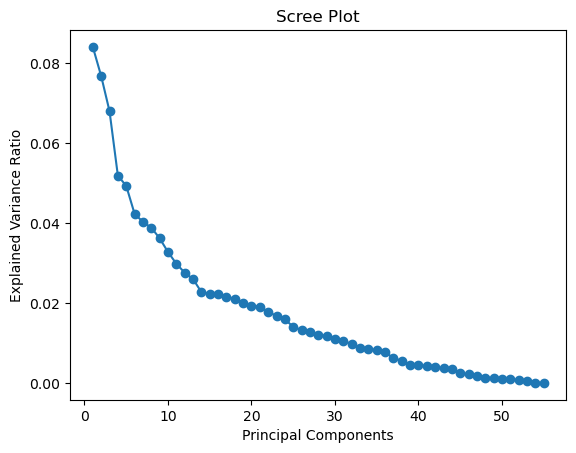

In [395]:
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.title('Scree Plot')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.show()

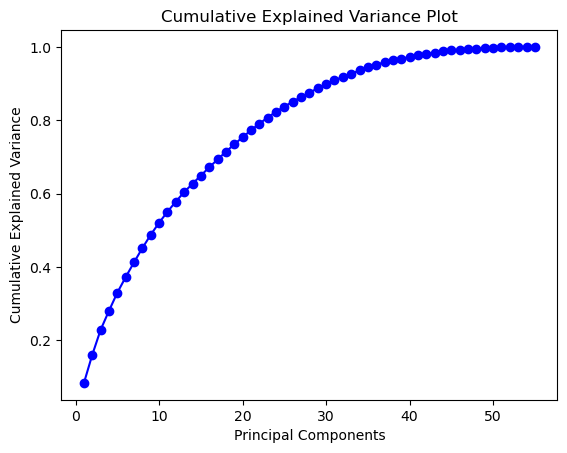

In [396]:
# Calculate cumulative explained variance
cumulative_explained_variance = explained_variance_ratio.cumsum()

# Scree plot with cumulative explained variance
plt.plot(range(1, len(explained_variance_ratio) + 1), cumulative_explained_variance, marker='o', linestyle='-', color='b')
plt.title('Cumulative Explained Variance Plot')
plt.xlabel('Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

Approximately 20 components is suggested from the plots.

Kaiser Criterion

In [397]:
# Calculate the average eigenvalue
average_eigenvalue = np.mean(eigenvalues)
# Identify components to retain based on Kaiser criterion
components_to_retain = np.where(eigenvalues > average_eigenvalue)[0]
components_to_retain

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20])

In [398]:
# Retain only the selected components
X_train_pca_kaiser = X_train_pca[:, components_to_retain]
X_test_pca_kaiser = X_test_pca[:, components_to_retain]

Loadings

In [399]:
# Calculate loadings
loadings = eigenvectors * np.sqrt(eigenvalues)

# Access loadings for the selected components
loadings_selected = loadings[components_to_retain, :]
loadings_selected

array([[ 1.21253324e-01,  1.40976988e-01, -1.28380912e-01, ...,
        -8.06031328e-03, -7.26411261e-03,  1.24355846e-13],
       [ 6.66333621e-02,  3.13565639e-01, -2.07927618e-01, ...,
         3.50268209e-03, -3.99134362e-03, -1.29159132e-13],
       [ 3.24611171e-02, -8.02020598e-01,  8.26873905e-01, ...,
        -2.14110030e-03, -5.89713776e-03, -6.07419880e-14],
       ...,
       [-5.05633613e-01, -9.16143369e-02,  1.82468744e-01, ...,
         8.57195623e-02,  3.53093847e-03, -1.83658546e-14],
       [ 4.60941035e-01,  3.54917625e-02,  6.93024943e-02, ...,
        -2.41711845e-02,  8.13179877e-03,  3.53176201e-14],
       [ 4.44179935e-01,  1.25245325e-02, -1.49004885e-02, ...,
        -8.02820630e-02,  1.57400927e-03,  2.77589417e-14]])

Varimax Transformation

Determine which variables are more strongly associated with each principal component.

In [400]:
from factor_analyzer import Rotator

In [401]:
rotator = Rotator()
loadings_rotated = rotator.fit_transform(loadings_selected)
loadings_rotated

array([[ 1.82327525e-02,  4.95528060e-17, -6.30016194e-02, ...,
        -3.93835513e-17,  3.07330758e-17, -9.77281752e-29],
       [ 2.22651713e-02,  9.80509543e-17, -1.72224133e-01, ...,
        -1.32004619e-16,  6.60406239e-18,  3.38390029e-28],
       [ 2.89859094e-02, -7.01985221e-17,  1.46040396e+00, ...,
         2.09472964e-16,  5.56536530e-17,  0.00000000e+00],
       ...,
       [-2.18421945e-01, -5.11197662e-18,  4.37714407e-02, ...,
        -5.66343021e-17, -1.34955251e-16, -2.46918337e-28],
       [ 1.43240179e-01,  3.32689567e-16,  2.43633809e-02, ...,
        -1.11263504e-17,  3.85540463e-17, -4.53315813e-28],
       [ 5.25605148e-01,  2.60094232e-16,  1.58082641e-02, ...,
         1.85632467e-17,  2.47217389e-17, -2.91626241e-28]])

In [402]:
rotated_loadings_df = pd.DataFrame(loadings_rotated, columns=X_train.columns)
print(rotated_loadings_df)

    n_tokens_title  n_tokens_content  n_unique_tokens  \
0         0.018233      4.955281e-17        -0.063002   
1         0.022265      9.805095e-17        -0.172224   
2         0.028986     -7.019852e-17         1.460404   
3        -0.037495     -2.959809e-18        -0.068507   
4        -0.022462     -2.933824e-16         0.048109   
5         0.009035     -2.161924e-16        -0.033952   
6        -0.008810      3.075616e-17        -0.068975   
7         0.059097     -7.996343e-18         0.018271   
8         0.019870     -3.679022e-17        -0.017221   
9         0.079307      1.218394e-16        -0.019584   
10       -0.011539     -2.675486e-16         0.054417   
11       -0.009572      1.640481e-16        -0.057440   
12        0.050707     -2.986066e-17         0.100547   
13        0.014445      9.894171e-16         0.081134   
14        0.064455      2.130786e-17        -0.007480   
15        0.013239      4.339160e-16        -0.036565   
16        0.090159      6.21513

Check the performance.

In [403]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

In [404]:
# Train a classifier (Logistic Regression) using the retained components
classifier = LogisticRegression()
classifier.fit(X_train_pca_kaiser, y_train)

# Make predictions on the test set
y_pred = classifier.predict(X_test_pca_kaiser)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy:", accuracy)

Test set accuracy: 0.6348628623423892


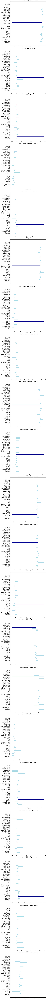

In [406]:
threshold = 0.5
num_components = rotated_loadings_df.shape[0]

fig, axes = plt.subplots(nrows=num_components, ncols=1, figsize=(10, 10 * num_components))
for i in range(num_components):
    important_variables = rotated_loadings_df.columns[abs(rotated_loadings_df.iloc[i, :]) > threshold].tolist()
    
    axes[i].barh(rotated_loadings_df.columns, rotated_loadings_df.iloc[i, :], color='lightblue')
    axes[i].barh(important_variables, rotated_loadings_df.loc[:, important_variables].iloc[i, :], color='darkblue')
    
    axes[i].set_title(f'Variables Based on Rotated Loadings (Factor {i+1})')
    axes[i].set_xlabel('Loading Values')

plt.tight_layout()
plt.show()

### Fisher criterion (LDA for binary target)

In [407]:
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

In [434]:
pipeline = Pipeline([
    ('feature_selection', SelectKBest(f_classif)),
    ('classifier', LogisticRegression())
])

param_grid = {
    'feature_selection__k': np.arange(1, X_train_scaled.shape[1] + 1)
}
grid_search = GridSearchCV(pipeline, param_grid, cv=5) 

In [435]:
grid_search.fit(X_train_scaled, y_train)
# Print the best parameter and corresponding performance
print("Best parameter (k):", grid_search.best_params_)
print("Best cross-validated accuracy:", grid_search.best_score_)

Best parameter (k): {'feature_selection__k': 53}
Best cross-validated accuracy: 0.6559199940040503


In [436]:
# Access the best model from the grid search
best_model = grid_search.best_estimator_

# Use the best model to make predictions on the test set
y_pred = best_model.predict(X_test_scaled)

# Evaluate accuracy on the test set
accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy:", accuracy)

Test set accuracy: 0.6563109320161186


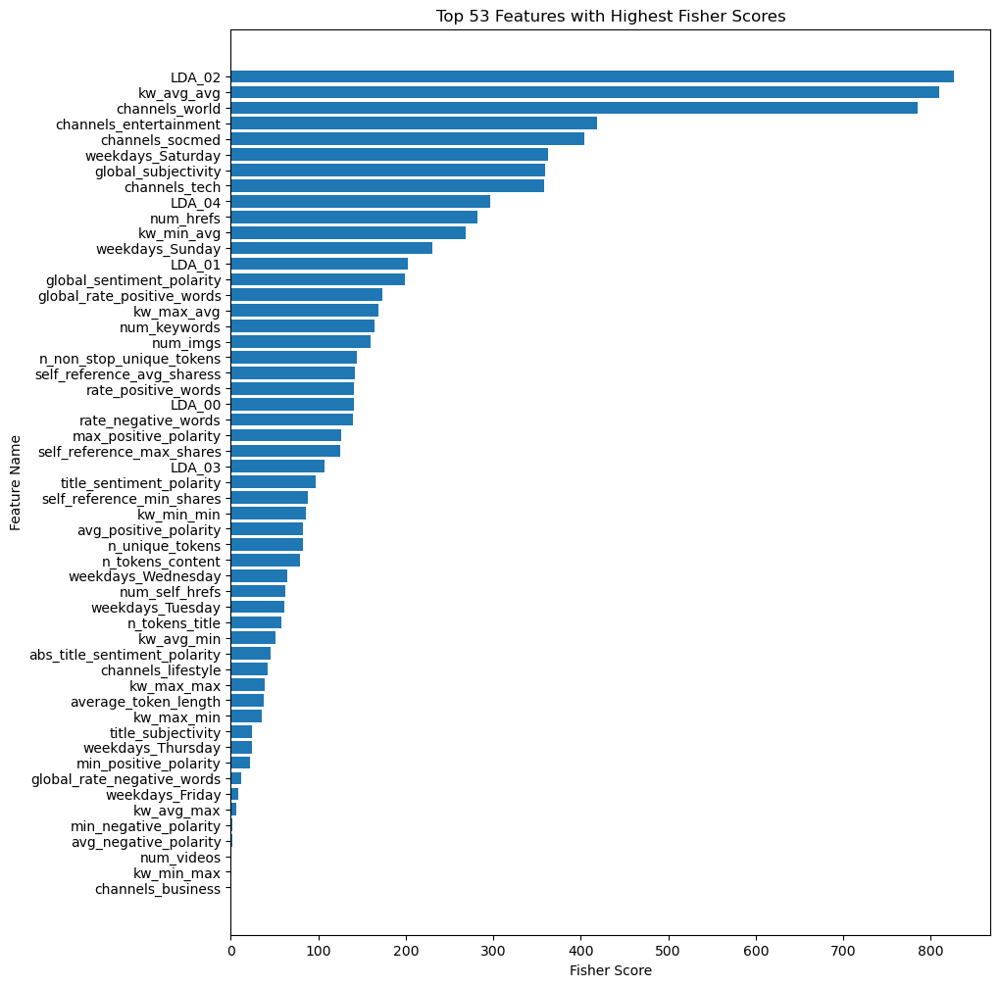

In [437]:
# Get the Fisher scores
f_scores = best_model.named_steps['feature_selection'].scores_

# Get the indices of the top 53 features with the highest Fisher scores
top_features_indices = np.argsort(f_scores)[-53:][::-1]
top_features = X_train.columns[top_features_indices]
fisher_selected = X_train[top_features]

# Sort the features and their scores in decreasing order
sorted_indices = np.argsort(f_scores)[::-1]
sorted_features = X_train.columns[sorted_indices]
sorted_scores = f_scores[sorted_indices]

# Plot the top 53 features
plt.figure(figsize=(10, 12)) 
plt.barh(range(1, 54), sorted_scores[:53][::-1], tick_label=sorted_features[:53][::-1])
plt.title('Top 53 Features with Highest Fisher Scores')
plt.xlabel('Fisher Score')
plt.ylabel('Feature Name')
plt.show()

### Mutual information

In [418]:
from sklearn.feature_selection import mutual_info_classif

In [419]:
pipeline = Pipeline([
    ('feature_selection', SelectKBest(mutual_info_classif)),
    ('classifier', LogisticRegression())
])

param_grid = {
    'feature_selection__k': np.arange(1, X_train_scaled.shape[1] + 1)
}

grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy')

In [420]:
grid_search.fit(X_train_scaled, y_train)
# Print the best parameter and corresponding performance
print("Best parameter (k):", grid_search.best_params_)
print("Best cross-validated accuracy:", grid_search.best_score_)

Best parameter (k): {'feature_selection__k': 50}
Best cross-validated accuracy: 0.657057433876196


In [421]:
# Access the best model from the grid search
best_model = grid_search.best_estimator_

# Use the best model to make predictions on the test set
y_pred = best_model.predict(X_test_scaled)

# Evaluate accuracy on the test set
accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy:", accuracy)

Test set accuracy: 0.655790978811907


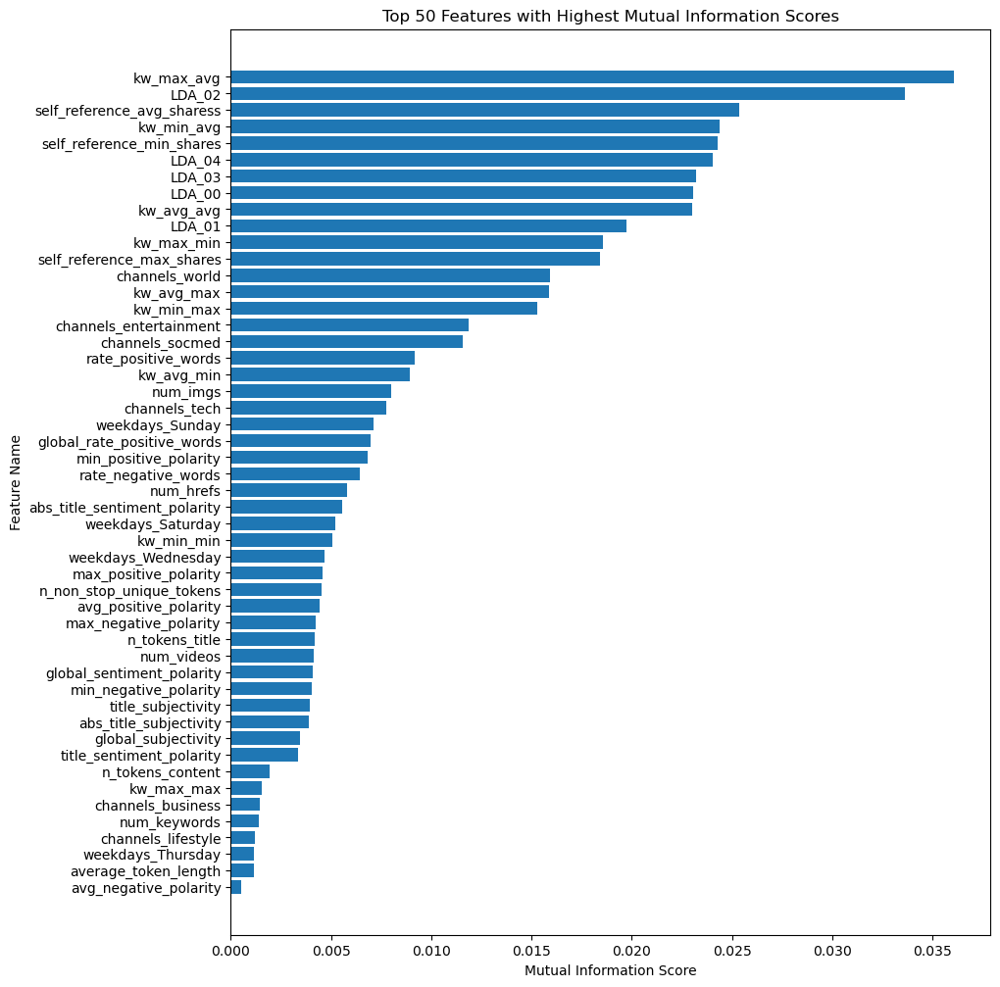

In [422]:
# Get the Mutual Information scores
mi_scores = best_model.named_steps['feature_selection'].scores_

# Get the indices of the top 50 features with the highest Mutual Information scores
top_features_indices = np.argsort(mi_scores)[-50:][::-1]
top_features = X_train.columns[top_features_indices]
MI_selected = X_train[top_features]

# Sort the features and their scores in decreasing order
sorted_indices = np.argsort(mi_scores)[::-1]
sorted_features = X_train.columns[sorted_indices]
sorted_scores = mi_scores[sorted_indices]

# Plot the top 50 features 
plt.figure(figsize=(10, 12))  
plt.barh(range(1, 51), sorted_scores[:50][::-1], tick_label=sorted_features[:50][::-1])
plt.title('Top 50 Features with Highest Mutual Information Scores')
plt.xlabel('Mutual Information Score')
plt.ylabel('Feature Name')
plt.show()

### Hypothesis Variables

In [429]:
hypo_variables = ['n_tokens_title', 'n_tokens_content', 'n_unique_tokens',
       'num_hrefs', 'num_self_hrefs', 'num_imgs',
       'num_videos', 'average_token_length', 'num_keywords', 
       'kw_max_min', 'kw_avg_min', 'kw_min_max', 'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares',
       'self_reference_max_shares', 'self_reference_avg_sharess', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
       'global_rate_negative_words', 'avg_positive_polarity', 'min_positive_polarity',
       'title_sentiment_polarity', 'weekdays_Friday',
       'weekdays_Saturday', 'weekdays_Sunday', 'weekdays_Thursday',
       'weekdays_Tuesday', 'weekdays_Wednesday', 'channels_business',
       'channels_entertainment', 'channels_lifestyle', 'channels_socmed',
       'channels_tech', 'channels_world']

In [432]:
# Transform scaled arrays back into DataFrames
X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=X_train.columns)

In [433]:
hypo_model = LogisticRegression()
hypo_model.fit(X_train_scaled_df[hypo_variables], y_train)
predictions = hypo_model.predict(X_test_scaled_df[hypo_variables])

accuracy = accuracy_score(y_test, predictions)
print("Accuracy:", accuracy)

Accuracy: 0.648901598856103


Since Fisher Criterion reached the highest test set accuracy 0.6563, I decided to use the result of this filter method (53 features) for the following analysis.

# Modeling

1. Linear Regression: it's good to build a baseline model, although this is a classification problem.
2. Logistic Regression
3. Support Vector Machine
    * Linear kernel
    * Polynomial kernel
    * Gaussian kernel
4. Random Forest( 500 Trees)

In [438]:
# filter out the selected features
selected_X_train_scaled = X_train_scaled_df[top_features]
selected_X_test_scaled = X_test_scaled_df[top_features]

selected_X_train_scaled.shape

(30769, 53)

### Linear Regression

To apply regression model on a classification problem, I reaissgned the target value to -1 and 1, and consider a prediction correct if its value and the actual result have the same sign (+ or -).

In [439]:
y_train_lm = y_train.replace(0, -1)
y_test_lm = y_test.replace(0, -1)
y_test_lm

4182     1
36625    1
11582    1
28974    1
32154   -1
        ..
8157    -1
3617    -1
31018    1
27683    1
10307    1
Name: popularity, Length: 7693, dtype: int64

In [440]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score

In [441]:
lm = LinearRegression()
lm.fit(selected_X_train_scaled, y_train_lm)

y_pred = lm.predict(selected_X_test_scaled)
y_pred_signed = np.where(y_pred < 0, -1, 1) # assign negative value to -1, otherwise 1

accuracy = accuracy_score(y_test_lm, y_pred_signed)
recall = recall_score(y_test_lm, y_pred_signed)
print("Accuracy:", accuracy)
print("Recall:", recall)


Accuracy: 0.6544910958013779
Recall: 0.6995362460336831


It looks good with 65% accuracy.

### Logistic Regression

In [442]:
logi_model = LogisticRegression()
logi_model.fit(selected_X_train_scaled, y_train)

y_pred = logi_model.predict(selected_X_test_scaled)

accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
print("Accuracy:", accuracy)
print("Recall:", recall)

Accuracy: 0.6563109320161186
Recall: 0.6997803270685867


### Support Vector Machine

Linear kernel has high bias problem. Polynomial and gaussian kernels can operate in a high-dimensional, implicit feature space without computing the coordinates of the data in that space. In this way, they can offer more flexible decision boundaries.

* Linear kernel
* Polynomial kernel
* Gaussian kernel = Radial Basis Function (RBF) kernel

In [443]:
from sklearn.svm import SVC

In [450]:
svc_model = SVC(random_state=42)
svc_model.fit(selected_X_train_scaled, y_train)

y_pred = svc_model.predict(selected_X_test_scaled)

accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
print("Accuracy:", accuracy)
print("Recall:", recall)

Accuracy: 0.6615104640582348
Recall: 0.7071027581156945


Optimize parameters with corss validation.

In [451]:
param_grid = [
    {
        'C': [0.1, 1, 10],
        'gamma': ['scale', 0.1, 1, 10],
        'kernel': ['linear', 'poly', 'rbf'],
        'degree': [3, 6, 9]
    }
]

grid_search = GridSearchCV(
    svc_model,
    param_grid,
    cv = 5,
    scoring = 'accuracy'
)

In [ ]:
grid_search.fit(selected_X_train_scaled, y_train)

# Print the best parameter and corresponding performance
print("Best parameter (k):", grid_search.best_params_)
print("Best cross-validated accuracy:", grid_search.best_score_)

### Random Forest ( 500 Trees)

In [456]:
from sklearn.ensemble import RandomForestClassifier

In [457]:
rf_model = RandomForestClassifier(n_estimators=500, criterion = 'gini', min_samples_split = 10, random_state=42)
rf_model.fit(selected_X_train_scaled, y_train)

y_pred = rf_model.predict(selected_X_test_scaled)

accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
print("Accuracy:", accuracy)
print("Recall:", recall)

Accuracy: 0.6676199142077213
Recall: 0.7254088357334635


The Random Forest model performed the best, achieving an accuracy of 0.67 and a recall of 0.73.

### Visualize the best model performance.

1. Confusion Matrix

In [458]:
from sklearn.metrics import confusion_matrix

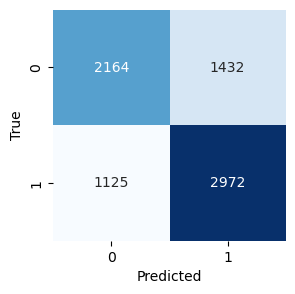

In [460]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(3,3))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

2. ROC curve

In [461]:
from sklearn.metrics import roc_curve, auc

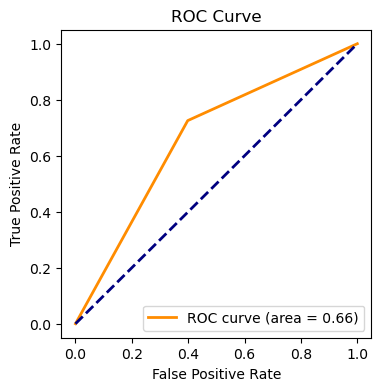

In [463]:
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(4,4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

3. Precision-Recall Curve

In [466]:
from sklearn.metrics import precision_recall_curve

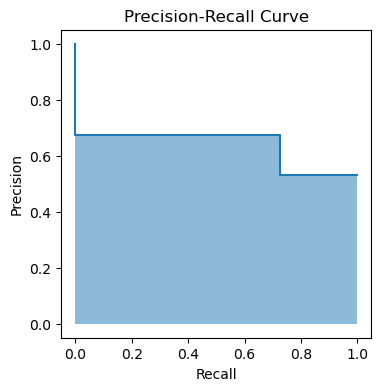

In [470]:
precision, recall, _ = precision_recall_curve(y_test, y_pred)

plt.figure(figsize=(4,4))
plt.step(recall, precision, where='post')
plt.fill_between(recall, precision, alpha = 0.5, step='post')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.show()

4. Feature Importance

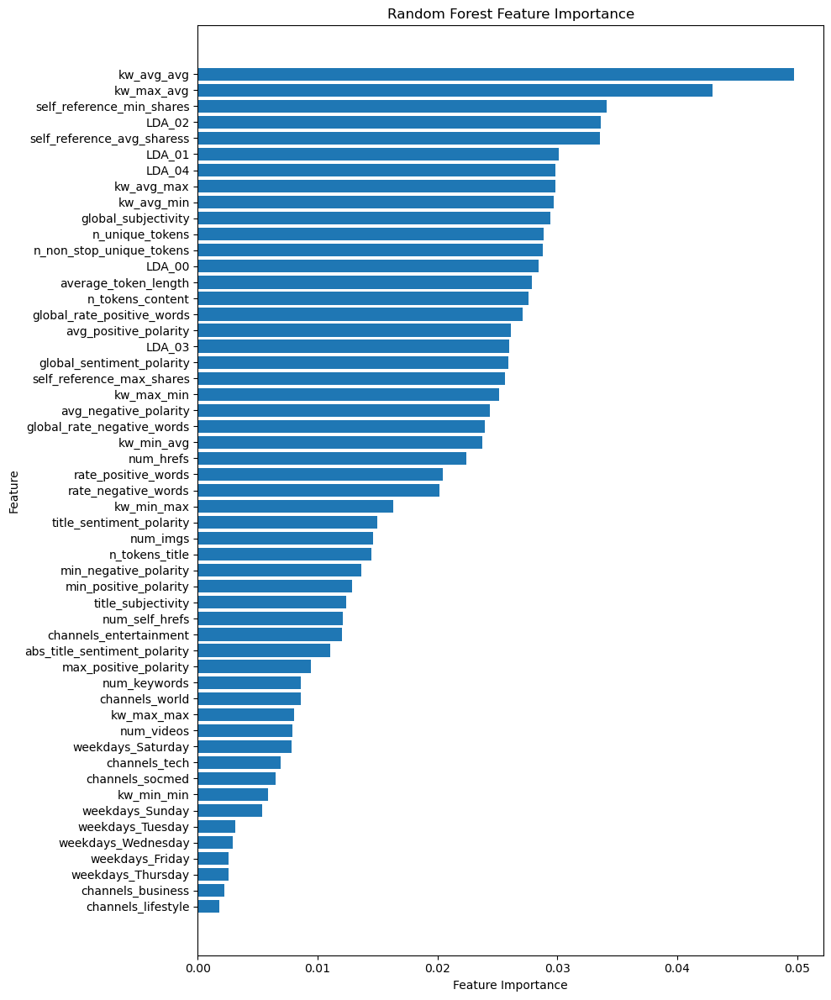

In [483]:
importances = rf_model.feature_importances_
feature_names = selected_X_train_scaled.columns

feature_importance = sorted(zip(importances, feature_names), reverse=False)
plt.figure(figsize=(10, 12)) 
plt.barh(range(1, len(importances) + 1), [imp[0] for imp in feature_importance], align='center')
plt.yticks(range(1, len(importances) + 1), [imp[1] for imp in feature_importance], fontsize=10)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Random Forest Feature Importance')
plt.tight_layout()
plt.show()

# Conclusion

The Random Forest model stands out as the best model in our classification analysis. It allows for trying different combination of parameters. However, we didn't delve into the content of articles. Features like LDA topics, which capture the article's essence, can be valuable for learning. To improve accuracy, incorporating article content as additional features would allow us to capture the true focus of the articles.

### References

1. He Ren, and Quan Yang. "Predicting and Evaluating the Popularity of Online News" 2015 cs229 projects
https://www.researchgate.net/publication/339909346_A_Comprehensive_Review_on_Online_News_Popularity_Prediction_using_Machine_Learning_Approach

2. Priyanka Rathord, et al. "A Comprehensive Review on Online News Popularity Prediction using Machine Learning Approach" 2019 SMART MOVES JOURNAL IJOSCIENCE 5(1):7
https://www.researchgate.net/publication/339909346_A_Comprehensive_Review_on_Online_News_Popularity_Prediction_using_Machine_Learning_Approach

3. Ayo Ayibiowu. "Exploratory Analysis For Online News Popularity - A deep insight analysis" 2020 kaggle.
https://www.kaggle.com/code/thehapyone/exploratory-analysis-for-online-news-popularity/notebook

4. Course handout